In [886]:
library('igraph')
library('Matrix')
library('pracma')

## Question 1:

In [897]:
data=read.table('facebook_combined.txt', sep=' ', header=FALSE)

Warning message in file(file, "rt"):
“cannot open file 'facebook_combined.txt': No such file or directory”

ERROR: Error in file(file, "rt"): cannot open the connection


In [889]:
set.seed(0)
g=graph.data.frame(data, directed=F)

In [ ]:
#set.seed(0)
#g=read_graph('facebook_combined.txt', format='ncol', directed=F)

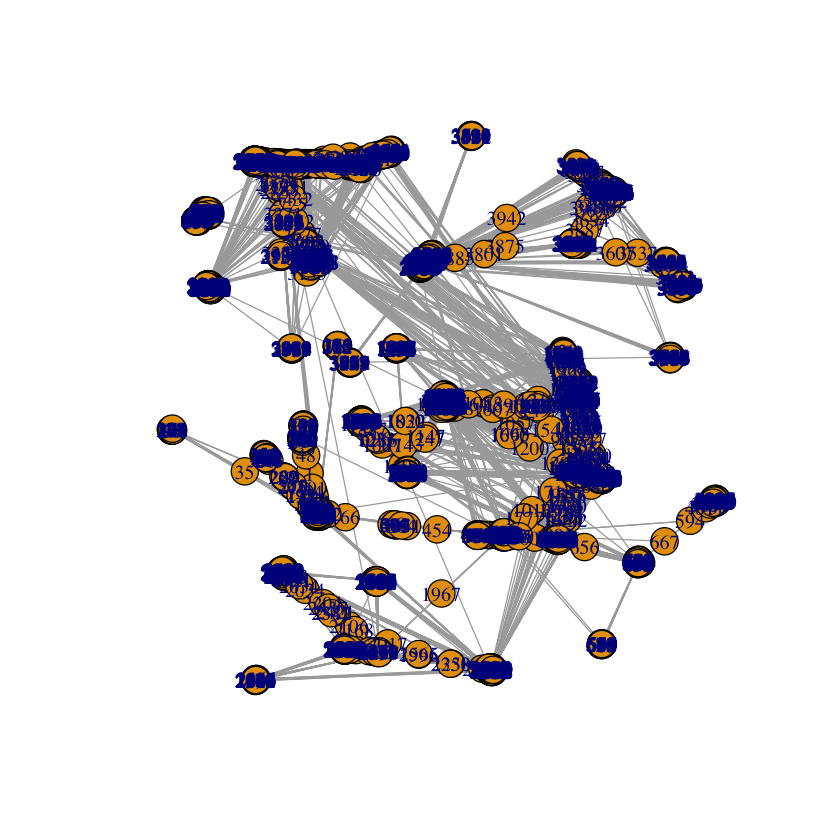

In [160]:
plot(g, vertex.size=10)

Question 1.1:

In [890]:
vcount(g) #number of nodes
ecount(g) #number of edges

[1] 4039

[1] 88234

Question 1.2:

In [11]:
is.connected(g)

[1] TRUE

## Question 2:

In [12]:
diameter(g)

[1] 8

## Question 3:

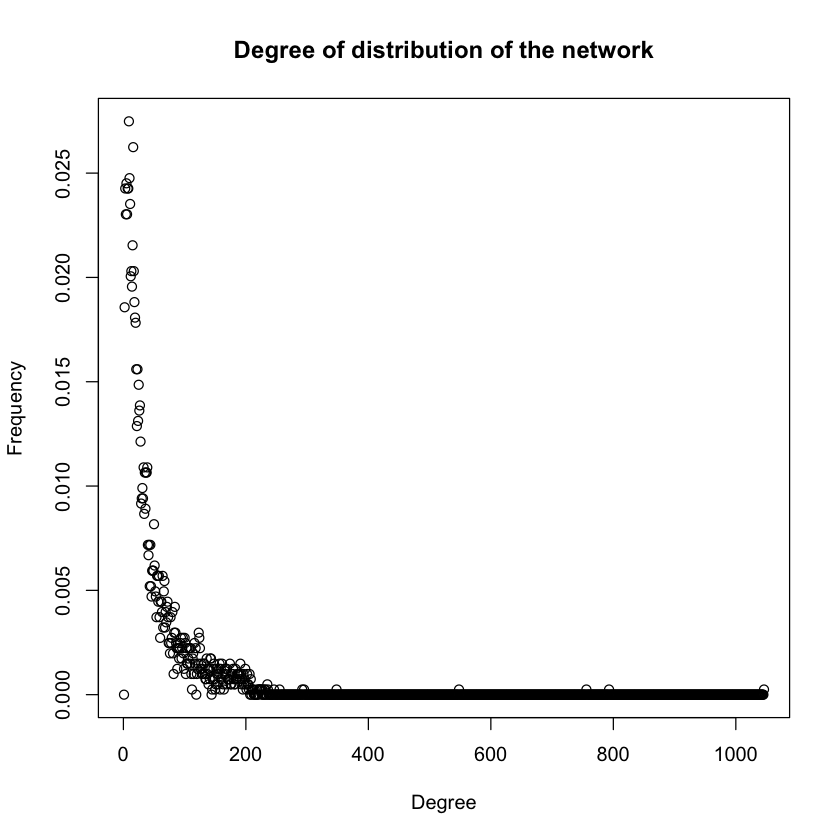

In [5]:
plot(degree_distribution(g), main='Degree of distribution of the network', xlab='Degree', ylab='Frequency')

In [15]:
mean(degree(g))

[1] 43.69101

## Question 4:

In [18]:
x=1:length(degree_distribution(g))
y=degree_distribution(g)
#y
y[y==0] <- NA
#y
lm(log(y)~log(x))


Call:
lm(formula = log(y) ~ log(x))

Coefficients:
(Intercept)       log(x)  
    -0.6611      -1.2475  


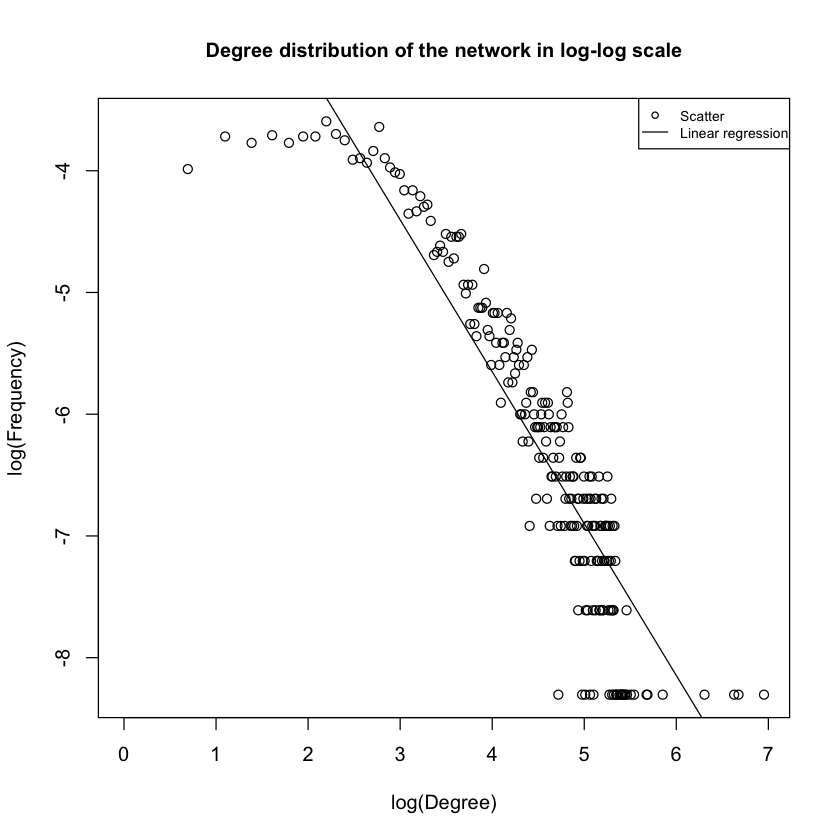

In [19]:
plot(log(x),log(y),main='Degree distribution of the network in log-log scale', 
     cex.main=1, xlab='log(Degree)', ylab='log(Frequency)')
abline(lm(log(y)~log(x)))
legend('topright', c('Scatter', 'Linear regression'), col=c('black','black'), 
       cex=0.7, lwd=1, lty=c(NA, 1), pch=c(1, NA))  #lwd= line width, lty=line type, pch=point symbol

## Question 5:

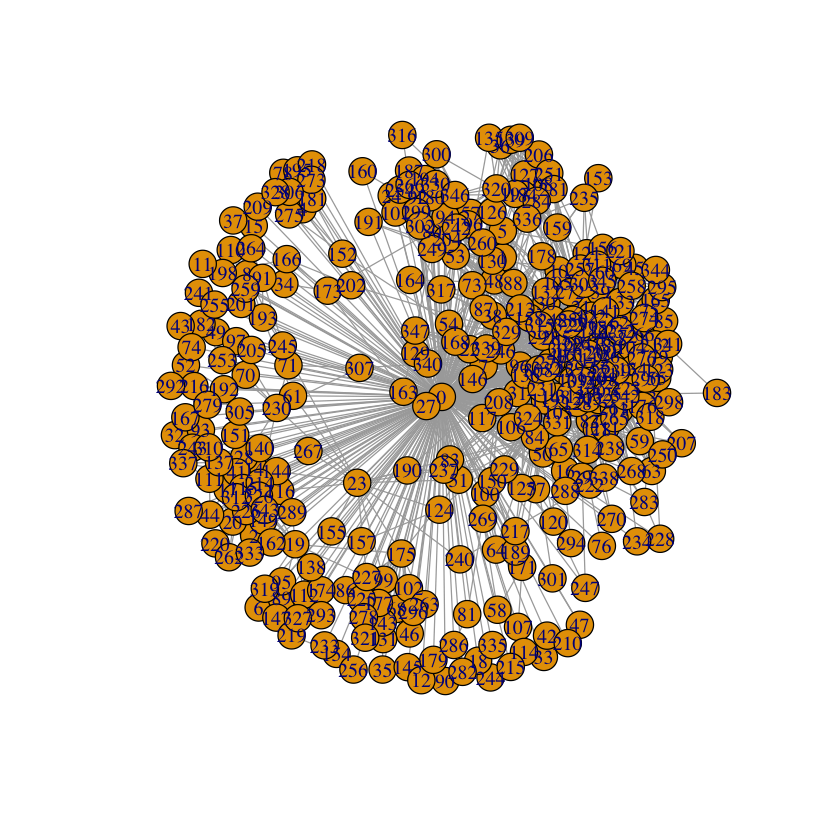

In [4]:
set.seed(0)
g1=make_ego_graph(g, order=1, nodes=V(g)[name==0], mode="all") #make_ego_graph preserves the vertex, edge and graph attributes
plot(g1[[1]], vertex.size=10)

In [7]:
ego_size(g, order=1, nodes=V(g)[name==0])
ego(g, order=1, nodes=V(g)[name==0])

[1] 348

[[1]]
+ 348/4039 vertices, named, from a9b28ab:
  [1] 0   1   2   3   4   5   6   7   8   9   10  13  14  16  17  19  20  21 
 [19] 22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  38  39  40 
 [37] 41  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60 
 [55] 61  62  63  64  65  66  67  68  69  70  71  72  73  75  76  77  78  79 
 [73] 80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97 
 [91] 98  99  100 101 102 103 104 105 106 107 108 109 110 111 112 113 115 116
[109] 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134
[127] 135 136 137 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153
[145] 154 155 156 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172
[163] 173 174 175 176 177 178 180 181 182 184 185 186 187 188 189 190 192 193
+ ... omitted several vertices


In [223]:
vcount(g1[[1]])
ecount(g1[[1]])

[1] 348

[1] 2866

## Question 6:

In [119]:
diameter(g1[[1]])

[1] 2

upper bound=2, because friend A connect to the central node and then connect to friend B;
lower bound=1, friend A and friend B could be directly connected on top of the central connection

## Question 7:

When the diameter of the personalized network is equal to the upper bound, which is 2, that means not all of your connections know each other. Friend A and friend B both connect you, but friend A and friend B do not have a direct connection.

When the diameter of the personalized network is equal to the lower bound, which is 1, that means all of your connections know each other. Friend A and friend B both connect you, and friend A and friend B also have a direct  connection.

## Question 8:

In [892]:
ego_size_list=ego_size(g, order = 1) #find the number of neighbors for each node
core_nodes_index= which(ego_size_list > 200) #filter the node index list and get only the node index that has number of neighbors more than 200
core_nodes_index
#core_nodes_degree=ego_size_list[core_nodes_index] #get the number of neighbors for the selected node index
core_nodes_degree=degree(g)[core_nodes_index]
core_nodes_degree
length(core_nodes_degree)
fprintf('Number of core nodes in the network: %d \n', length(core_nodes_degree)) 
mean(core_nodes_degree)
fprintf('Average degree of the core nodes in the network: %f \n', mean(core_nodes_degree)) 

[1]    1  100  288  419  954 1064 1211 1288 1436 1440 1514 1535 1577 1593 1611
[16] 1641 1665 1713 1723 1752 1795 1803 1857 1888 1932 1951 2014 2026 2037 2041
[31] 2048 2052 2074 2154 2216 2268 2310 2344 2360 2405 3156

0  107  348  483 1086 1199 1352 1431 1584 1589 1663 1684 1730 1746 1768 1800 
 347 1045  229  231  205  217  234  220  211  205  235  792  226  202  209  245 
1827 1888 1912 1941 1985 1993 2047 2078 2123 2142 2206 2218 2229 2233 2240 2244 
 201  254  755  223  224  203  205  204  203  221  210  205  207  222  201  200 
2266 2347 2410 2464 2507 2543 2560 2611 3437 
 234  291  207  202  201  294  201  207  547

[1] 41

Number of core nodes in the network: 41 


[1] 277.439

Average degree of the core nodes in the network: 277.439024 


In [5]:
ego_size(g, order = 1, nodes=V(g)[name == 1086])

[1] 206

In [218]:
V(g)[name == 348]

+ 1/4039 vertex, named, from 35a1c5f:
[1] 348

In [33]:
V(g)[11]

+ 1/4039 vertex, named, from b3e59ae:
[1] 10

In [896]:
ego_size(g, order = 1, nodes=11)

[1] 11

## Question 9:

In [6]:
community_structure= function(G, id){
    set.seed(0)
    g=make_ego_graph(G, order=1, nodes=V(G)[name == (id-1)], mode="all")[[1]]
    coords = layout_with_fr(g)

    cfg=cluster_fast_greedy(g)
    #modularity(cfg)
    fprintf('Node ID: %d, cluster_fast_greedy, modularity=%f \n', id, modularity(cfg)) 
    plot(g, vertex.color=membership(cfg), layout=coords, vertex.size=10)

    ceb = cluster_edge_betweenness(g)
    #modularity(ceb)
    fprintf('Node ID: %d, cluster_edge_betweenness, modularity=%f \n', id, modularity(ceb)) 
    plot(g, vertex.color=membership(ceb), layout=coords, vertex.size=10)

    cim = cluster_infomap(g)
    #modularity(cim)
    fprintf('Node ID: %d, cluster_infomap, modularity=%f \n', id, modularity(cim)) 
    plot(g, vertex.color=membership(cim), layout=coords, vertex.size=10)
}

Node ID: 1, cluster_fast_greedy, modularity=0.413101 
Node ID: 1, cluster_edge_betweenness, modularity=0.353302 


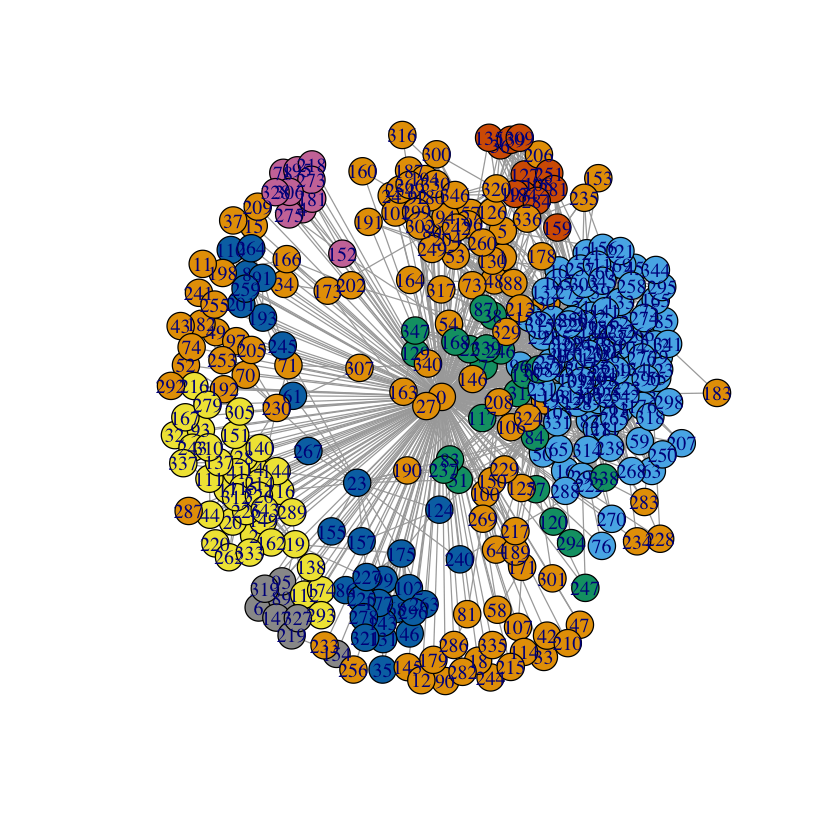

Node ID: 1, cluster_infomap, modularity=0.389118 


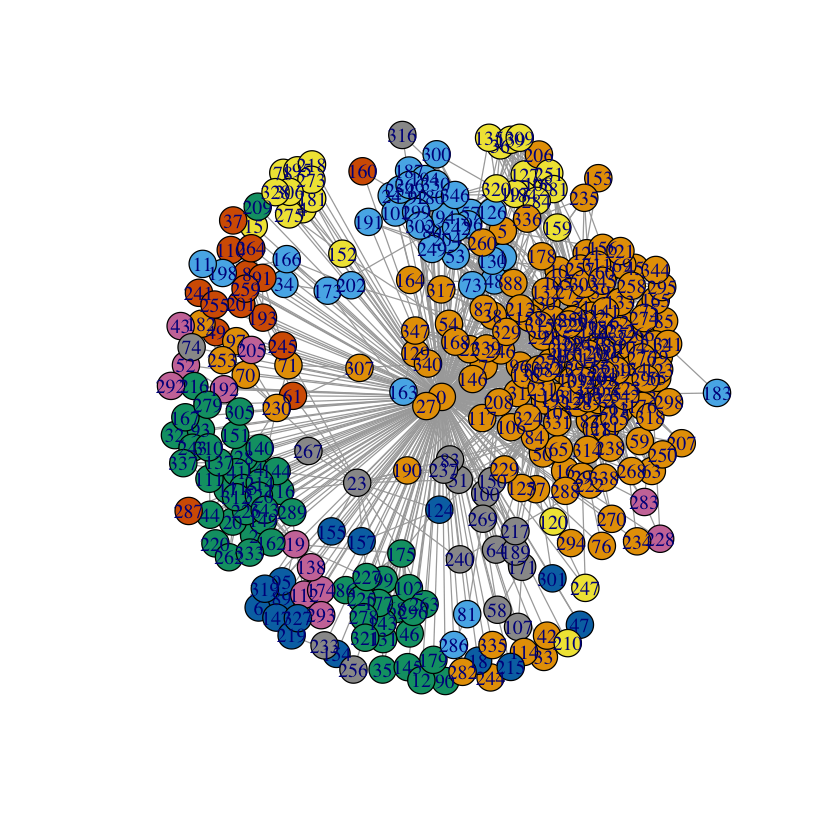

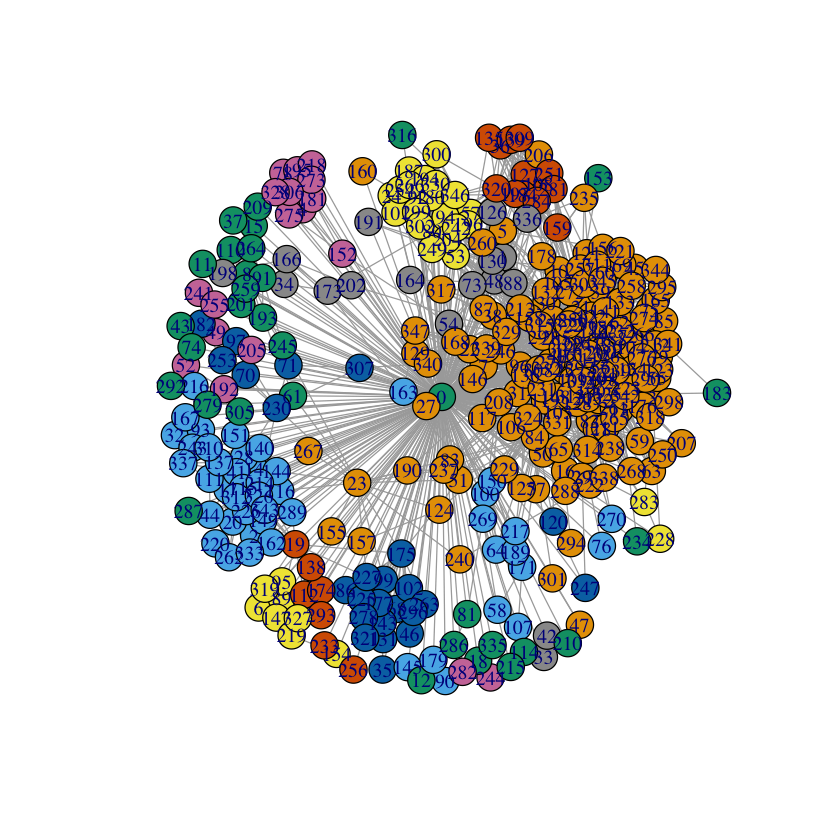

In [226]:
community_structure(g, 1)

Node ID: 108, cluster_fast_greedy, modularity=0.435929 
Node ID: 108, cluster_edge_betweenness, modularity=0.506755 


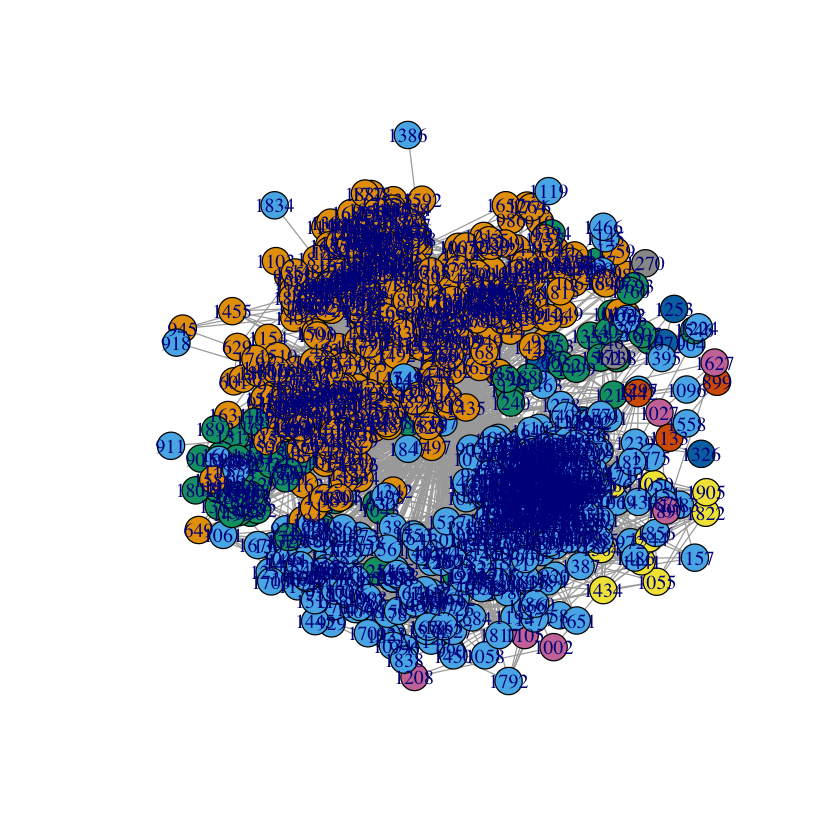

Node ID: 108, cluster_infomap, modularity=0.508223 


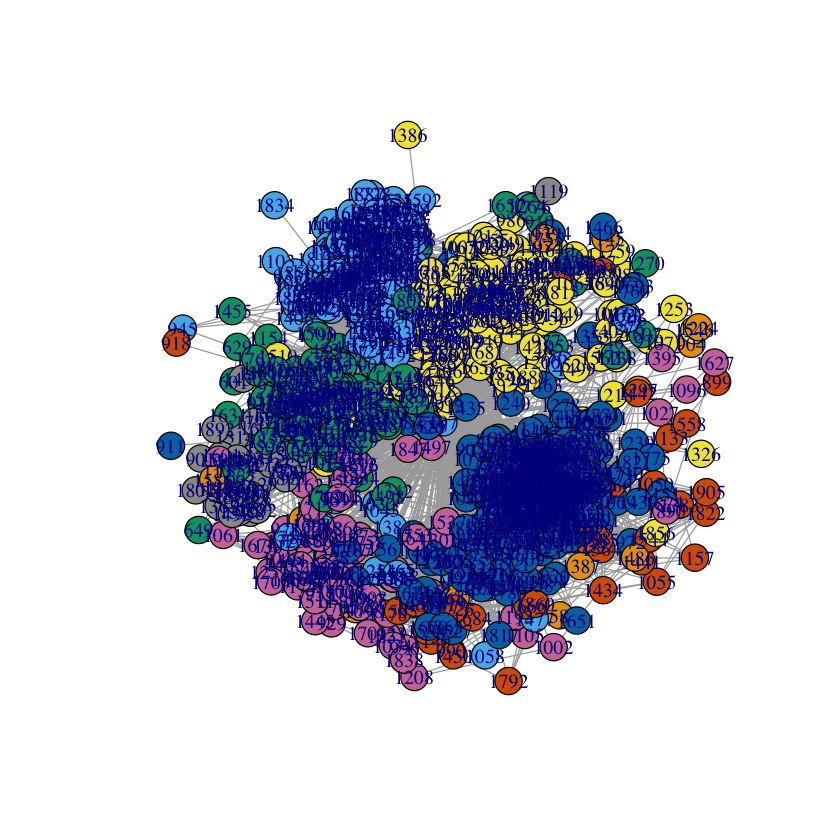

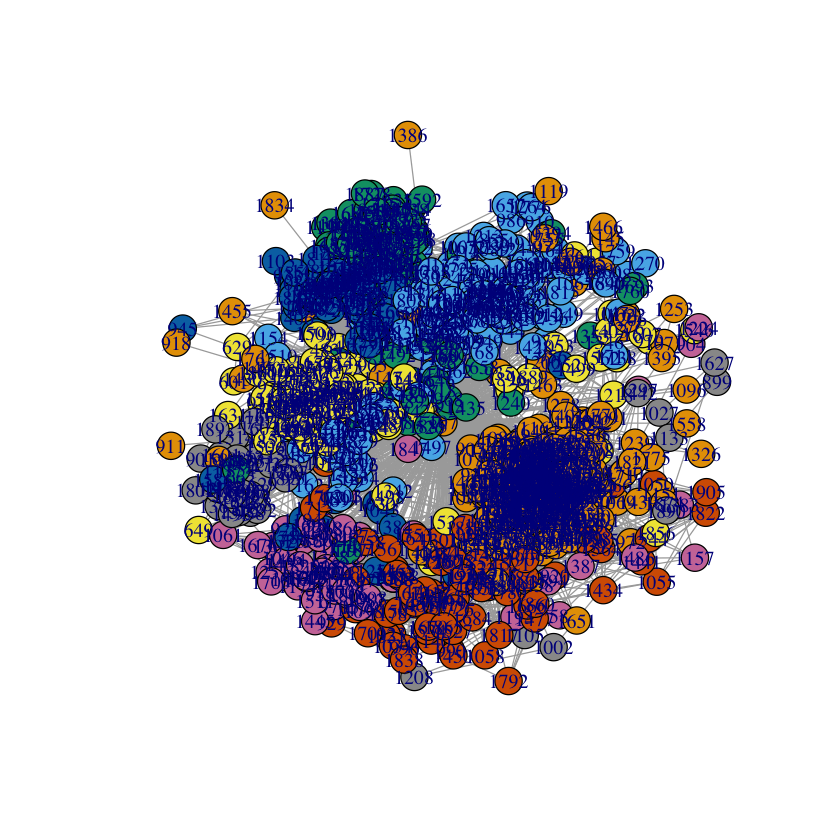

In [12]:
community_structure(g,108)

Node ID: 349, cluster_fast_greedy, modularity=0.250210 
Node ID: 349, cluster_edge_betweenness, modularity=0.133528 


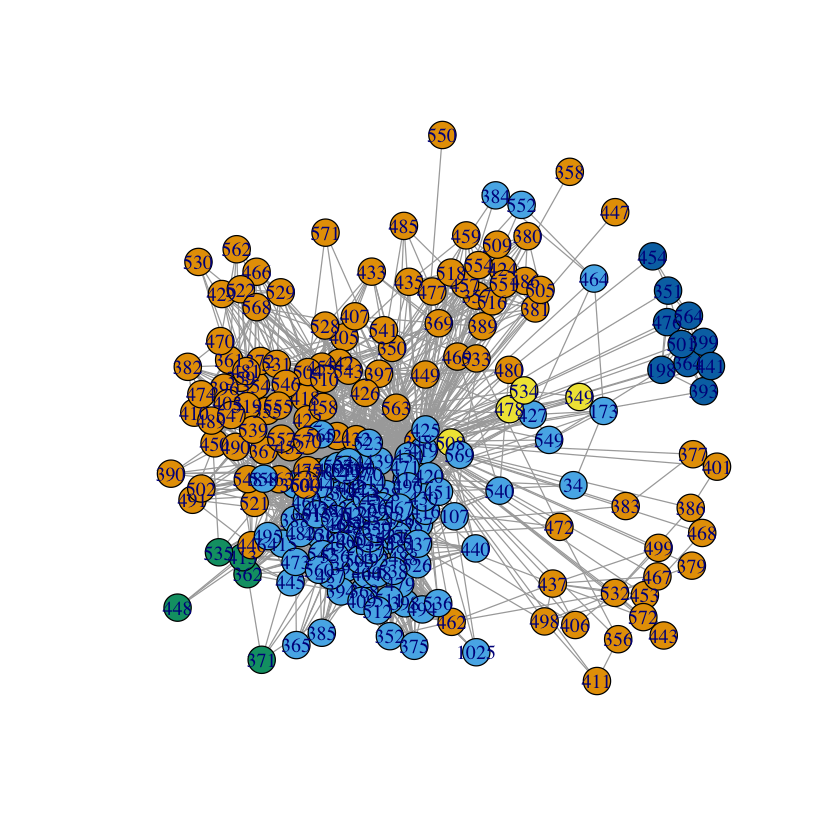

Node ID: 349, cluster_infomap, modularity=0.096029 


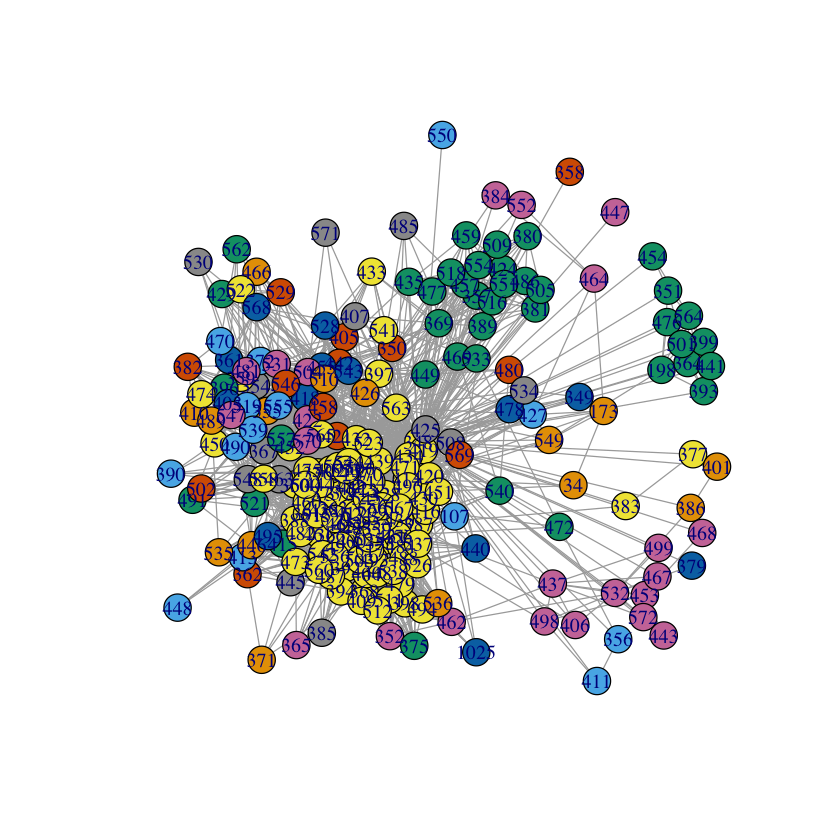

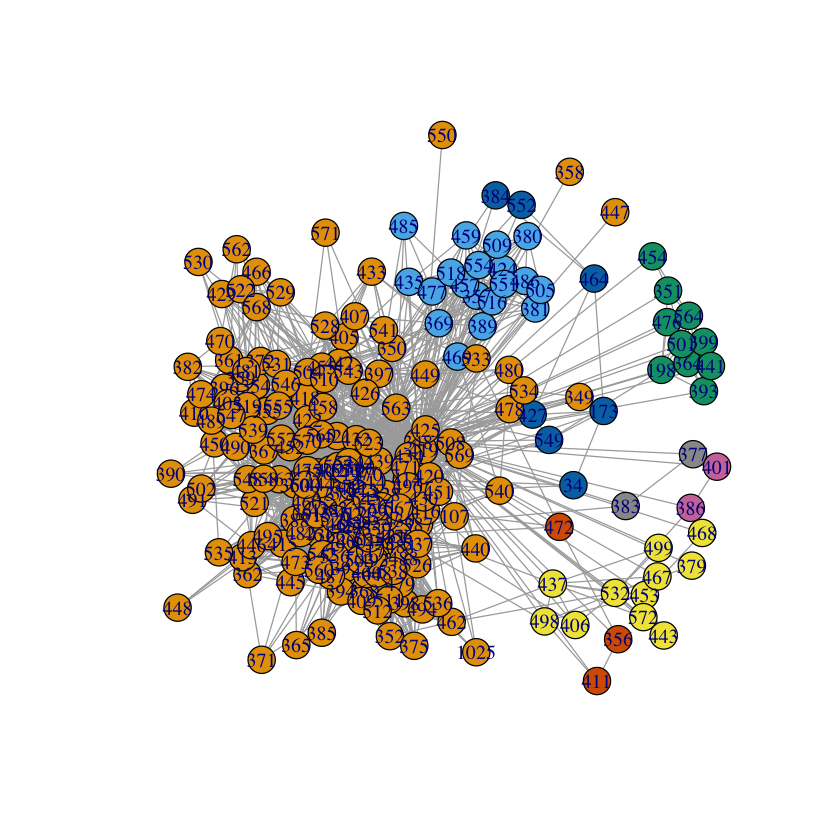

In [7]:
community_structure(g,349)

Node ID: 484, cluster_fast_greedy, modularity=0.507002 
Node ID: 484, cluster_edge_betweenness, modularity=0.489095 


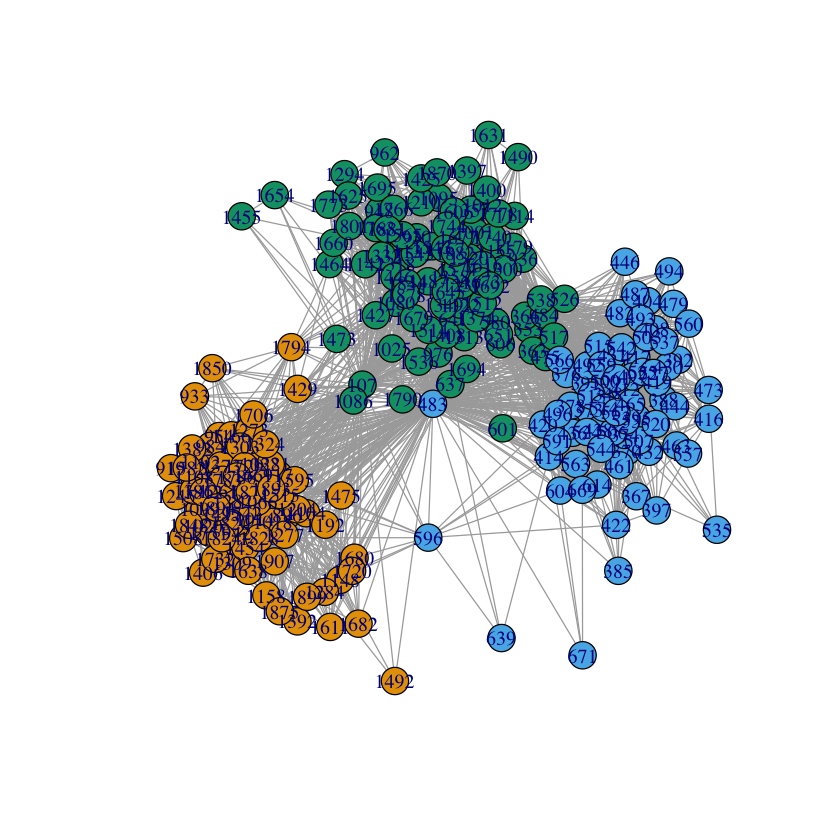

Node ID: 484, cluster_infomap, modularity=0.515643 


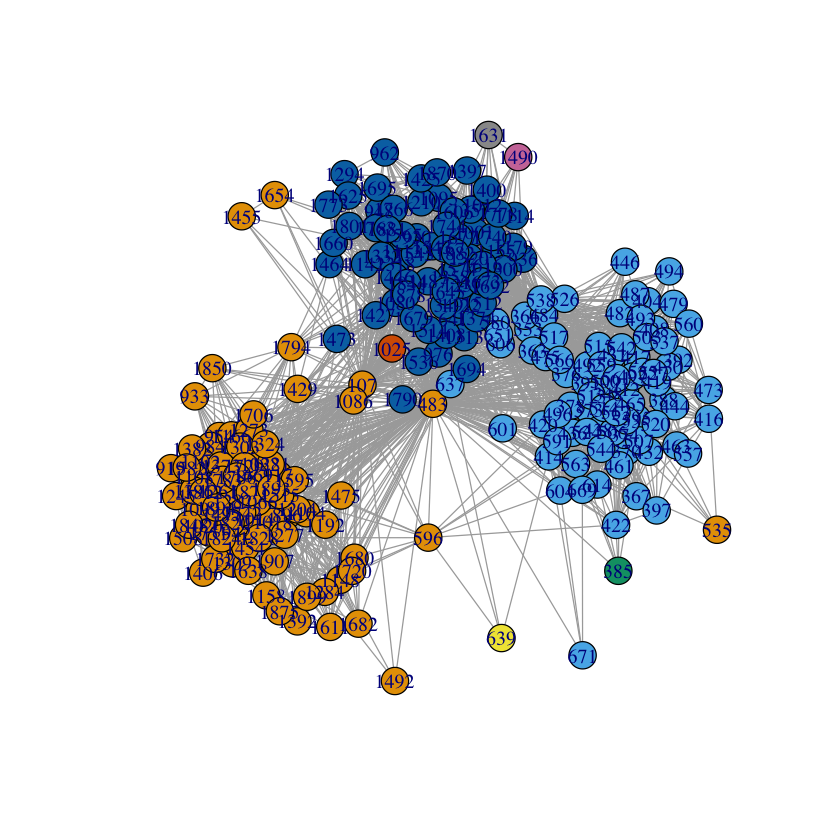

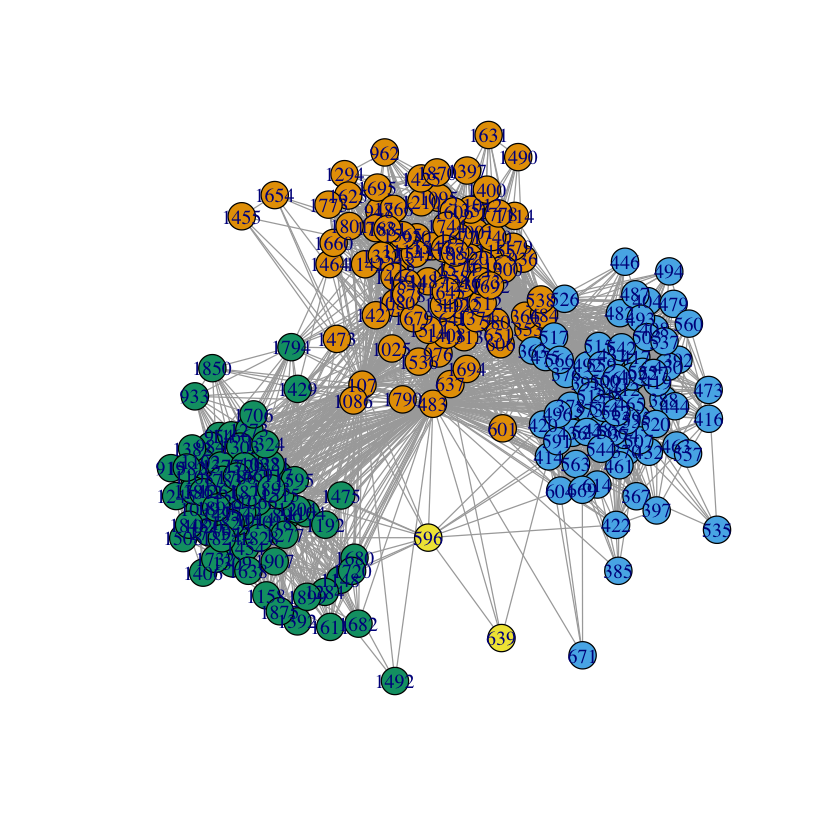

In [8]:
community_structure(g,484)

Node ID: 1087, cluster_fast_greedy, modularity=0.145531 
Node ID: 1087, cluster_edge_betweenness, modularity=0.027624 


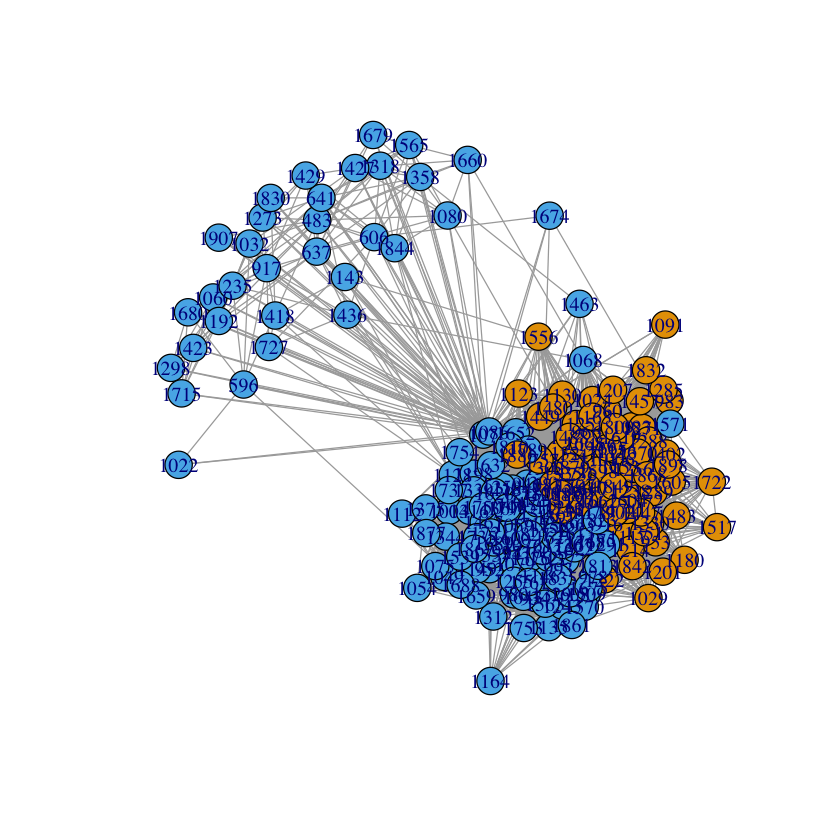

Node ID: 1087, cluster_infomap, modularity=0.026907 


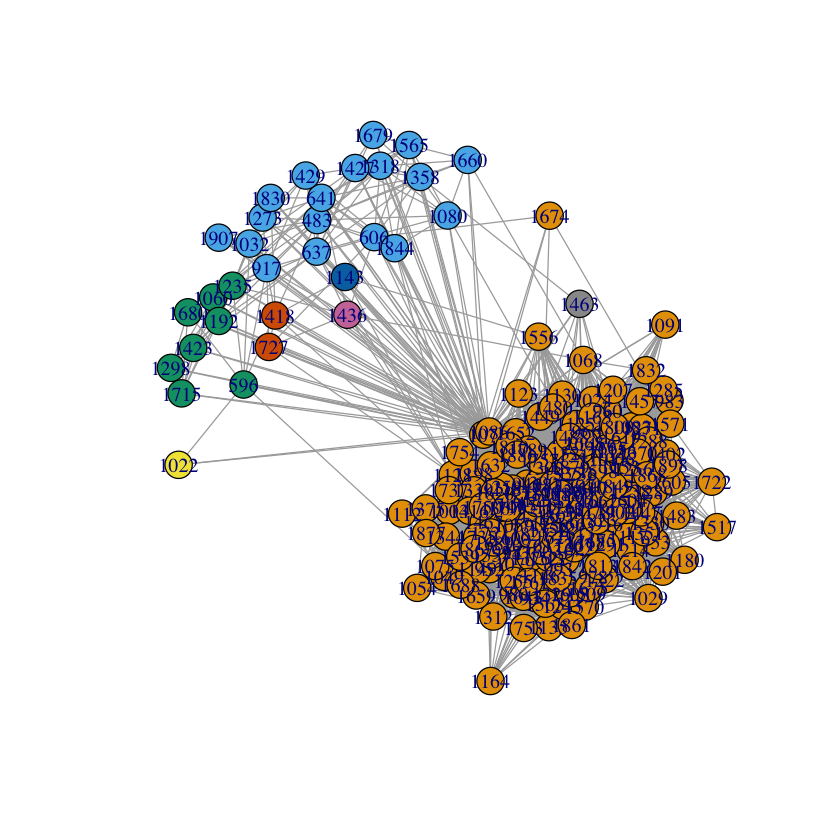

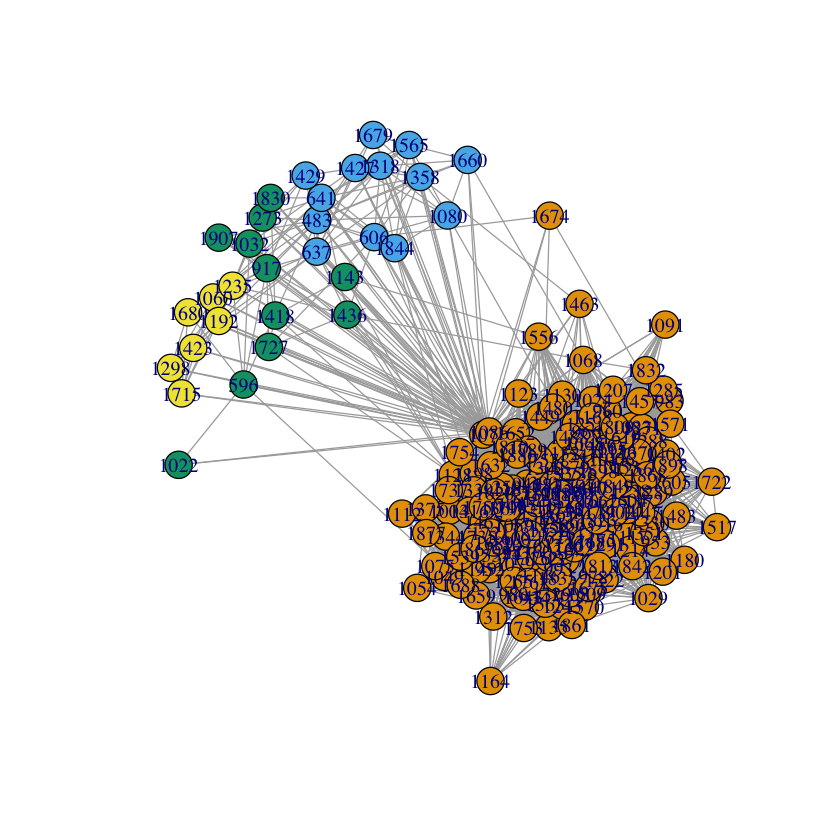

In [9]:
community_structure(g,1087)

## Question 10:

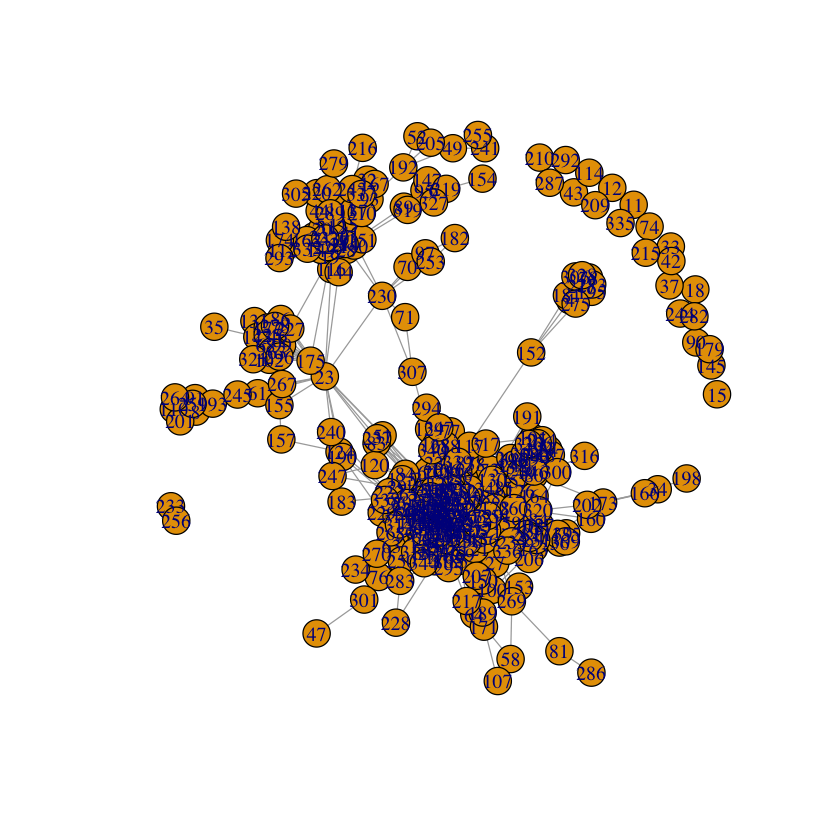

In [11]:
set.seed(0)
G1=g1[[1]]-V(g1[[1]])[name==(1-1)]
plot(G1, vertex.size=10)

In [38]:
vcount(g1[[1]])
vcount(G1)
degree(G1)

[1] 348

[1] 347

1   2   3   4   5   6   7   8   9  10  13  14  16  17  19  20  21  22  23  24 
 16   9  16   9  12   5  19   7  56   9  30  14   8  12  15  14  64  10  16  15 
 25  26  27  28  29  30  31  32  33  34  35  36  38  39  40  41  44  45  46  47 
 68  67   4  12  12  16  22   5   1   1   1  10   8  14  43  23   5  11   4   1 
 48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67 
 21   3  10   6   1  30   7  16  77  14   3  18   7   2  25   5   6  11  14  75 
 68  69  70  71  72  73  75  76  77  78  79  80  81  82  83  84  85  86  87  88 
  8   9   1   2  23   9  13   2   5   8  11  22   2  33   6  12  13   5  12  19 
 89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 
  7   1   7  20   7  21   5   8   2  48  12   8  18   5  15  31  13   7   2  12 
109 110 111 112 113 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 
 36   4  13   2  39  20  16   5  35  61   3  11  62  17   3   3   6  15  27   6 
130 131 132 133 134 135 136 137 139 140 141 142 143 144 145 146 147 148 149 150 
 15   6  15  17  18   9  21  15   8  10  27  42  11  14   1   9   5  19  13  10 
151 152 153 154 155 156 158 159 160 161 162 163 164 165 166 167 168 169 170 171 
  6   4   1   1   2  11  24  13   1  24   7   5   2  10   3   6  10  37  45   7 
172 173 174 175 176 177 178 180 181 182 184 185 186 187 188 189 190 192 193 194 
 40   5   3  16  13  10  12  19   9   2  17  25  43  15  47   6   3   4   4  18 
195 196 197 198 199 200 201 202 203 204 206 207 208 211 212 213 214 216 217 218 
  8  12  15   1  46  56   3   3  56  21   3   2   6  29  17  38  16   1   7   8 
219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 236 238 239 242 
  5   3   7  10  26  27   9  13  14   2   5   8  20  24   1   1  36  22  58  23 
243 244 245 246 248 249 250 251 252 254 257 258 259 260 261 262 263 265 266 268 
  7   1   4  13  20  23   4  13  64  16  17  14   7   7  37   3   6  26  17  10 
269 271 272 273 274 275 276 277 280 281 284 285 288 290 291 297 299 300 301 302 
  5  72  44   8  13   9  17  64  42  15  15  46   3  13  35  24  19   6   2  19 
303 304 305 306 308 309 310 311 312 313 314 315 318 319 320 322 323 324 325 326 
 20  54   1   8  23   9  12   6  25  36  12  55  10   7  20  71  38  25  38  18 
329 330 331 333 334 339  11  12  15  18  37  42  43  74 114 138 157 179 183 191 
 29  15  19   7  27  26   0   0   0   0   0   1   0   0   0   1   2   2   1   2 
205 209 210 215 235 237 240 241 247 253 255 256 264 267 270 278 279 282 283 286 
  1   0   0   0   4   6   2   1   2   2   1   1   4   1   3   9   1   1   4   1 
287 289 292 293 294 295 296 298 307 316 317 321 327 328 332 335 336 337 338 340 
  0   3   0   2   2   9   6  10   3   1   6   2   3   8  42   0   2   8   6   5 
341 342 343 344 345 346 347 
 11  33  17   8  15  26   6

In [57]:
degree(G1, v=V(G1)[name==11]) #node id =11
degree(G1, v=11) #node index =11

11 
 0

13 
30

[1] 0.4418533

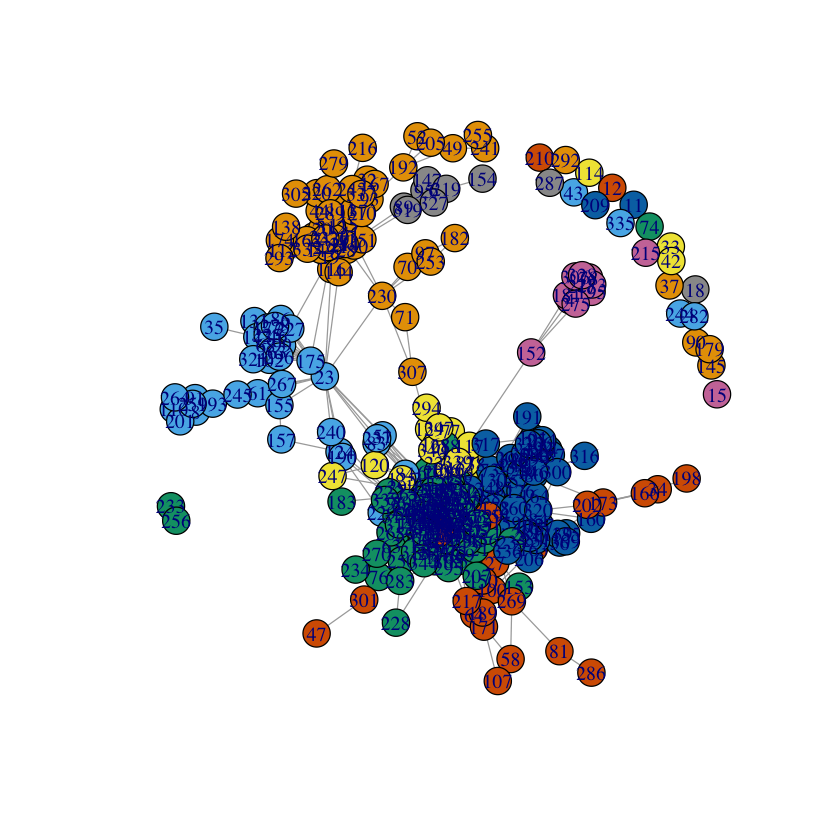

In [40]:
set.seed(0)
coords = layout_with_fr(G1)
#coords = layout_with_fr(g1[[1]])

cfg=cluster_fast_greedy(G1)
modularity(cfg)
#fprintf('Node ID: %d, cluster_fast_greedy, modularity=%f \n', id, modularity(cfg)) 
plot(G1, vertex.color=membership(cfg), layout=coords, vertex.size=10)

In [48]:
community_structure2= function(G, id){
    set.seed(0)
    gg=make_ego_graph(G, order=1, nodes=V(G)[name == (id-1)], mode="all")[[1]]
    g = gg-V(gg)[name==(id-1)]
    coords = layout_with_fr(g)

    cfg=cluster_fast_greedy(g)
    #modularity(cfg)
    fprintf('Node ID: %d, cluster_fast_greedy, modularity=%f \n', id, modularity(cfg)) 
    plot(g, vertex.color=membership(cfg), layout=coords, vertex.size=10)

    ceb = cluster_edge_betweenness(g)
    #modularity(ceb)
    fprintf('Node ID: %d, cluster_edge_betweenness, modularity=%f \n', id, modularity(ceb)) 
    plot(g, vertex.color=membership(ceb), layout=coords, vertex.size=10)

    cim = cluster_infomap(g)
    #modularity(cim)
    fprintf('Node ID: %d, cluster_infomap, modularity=%f \n', id, modularity(cim)) 
    plot(g, vertex.color=membership(cim), layout=coords, vertex.size=10)
}

Node ID: 1, cluster_fast_greedy, modularity=0.441853 
Node ID: 1, cluster_edge_betweenness, modularity=0.416146 


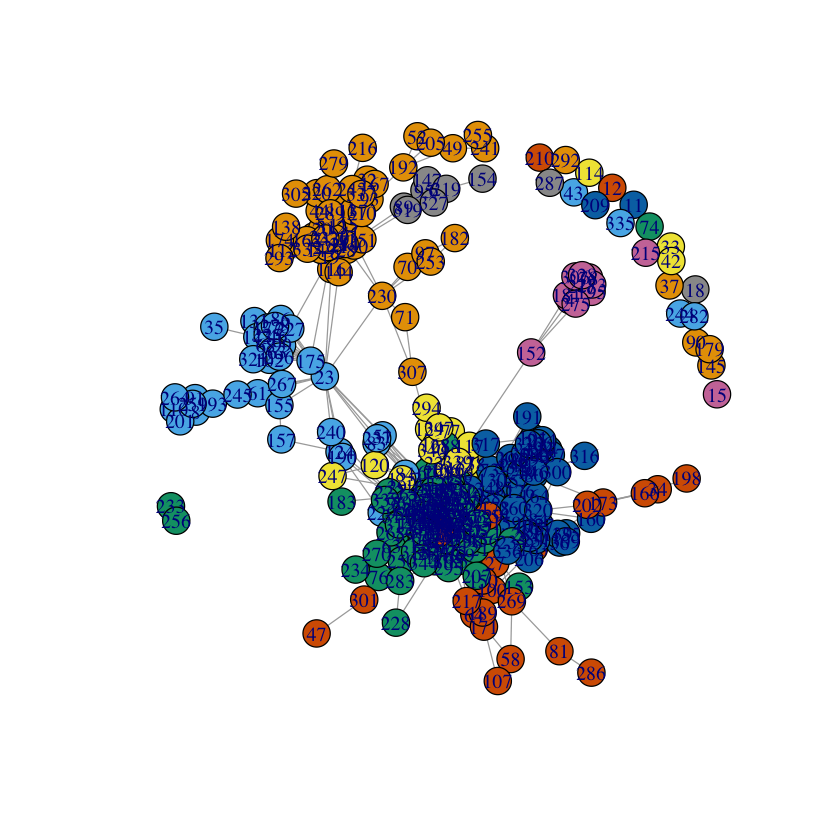

Node ID: 1, cluster_infomap, modularity=0.418008 


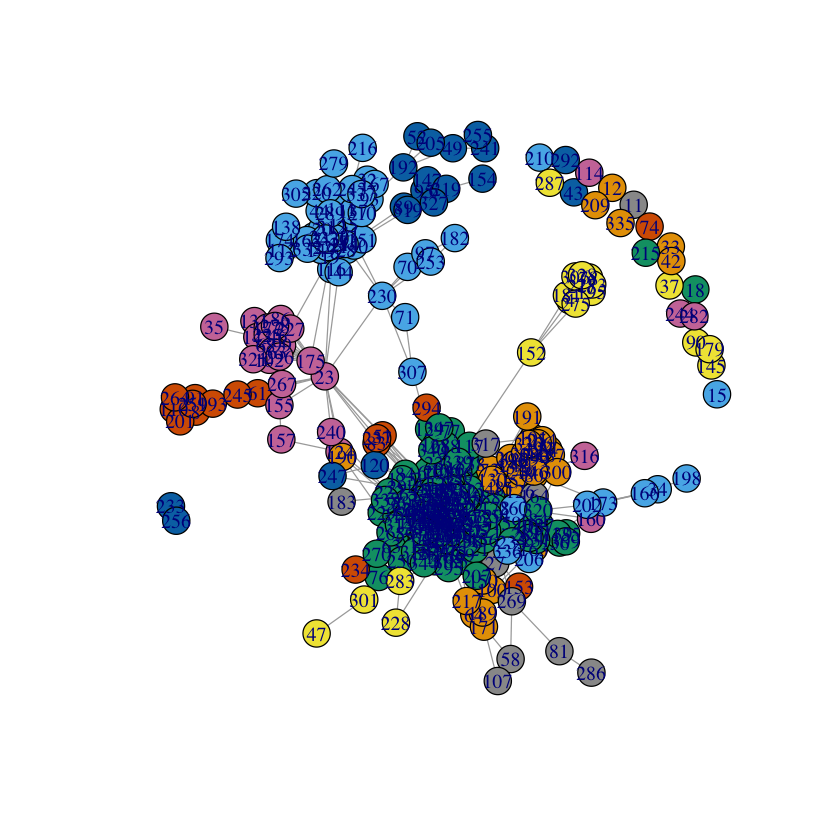

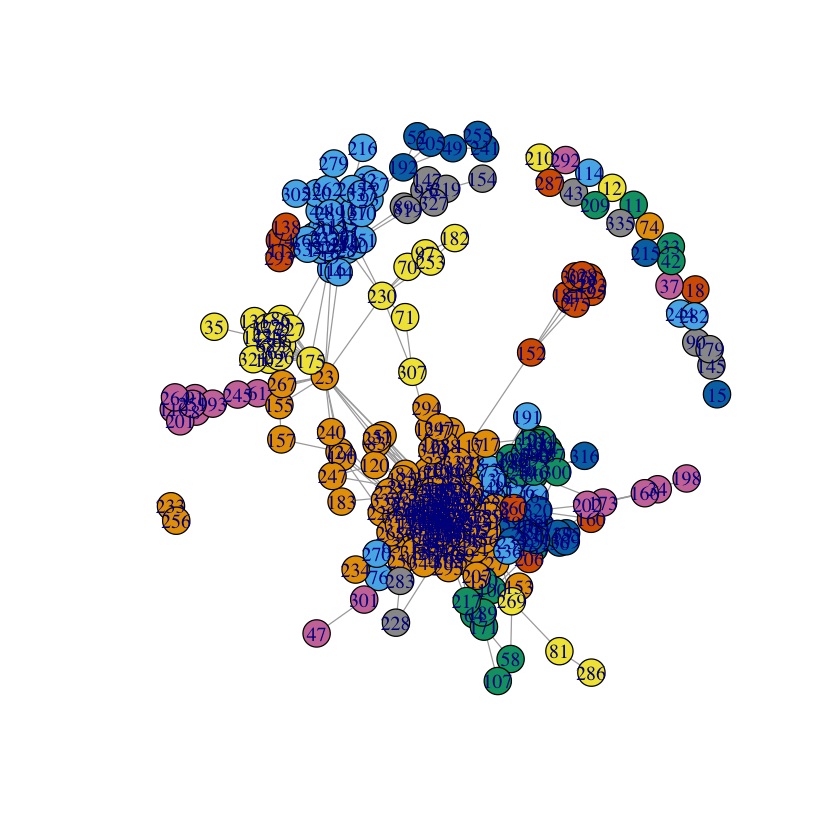

In [42]:
community_structure2(g, 1)

Node ID: 108, cluster_fast_greedy, modularity=0.458060 
Node ID: 108, cluster_edge_betweenness, modularity=0.521322 


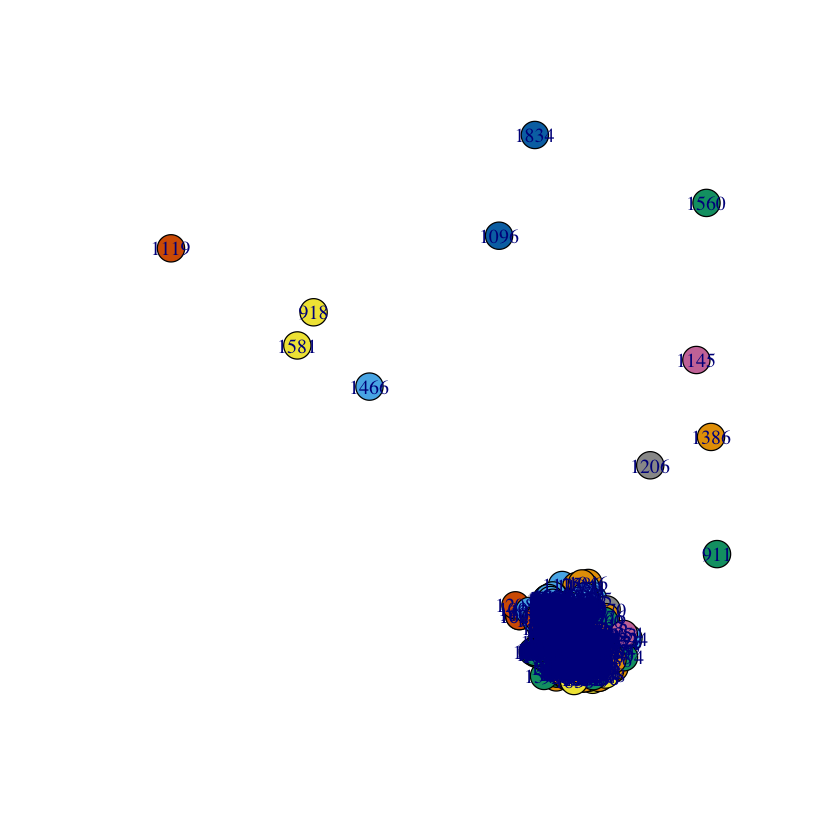

Node ID: 108, cluster_infomap, modularity=0.520517 


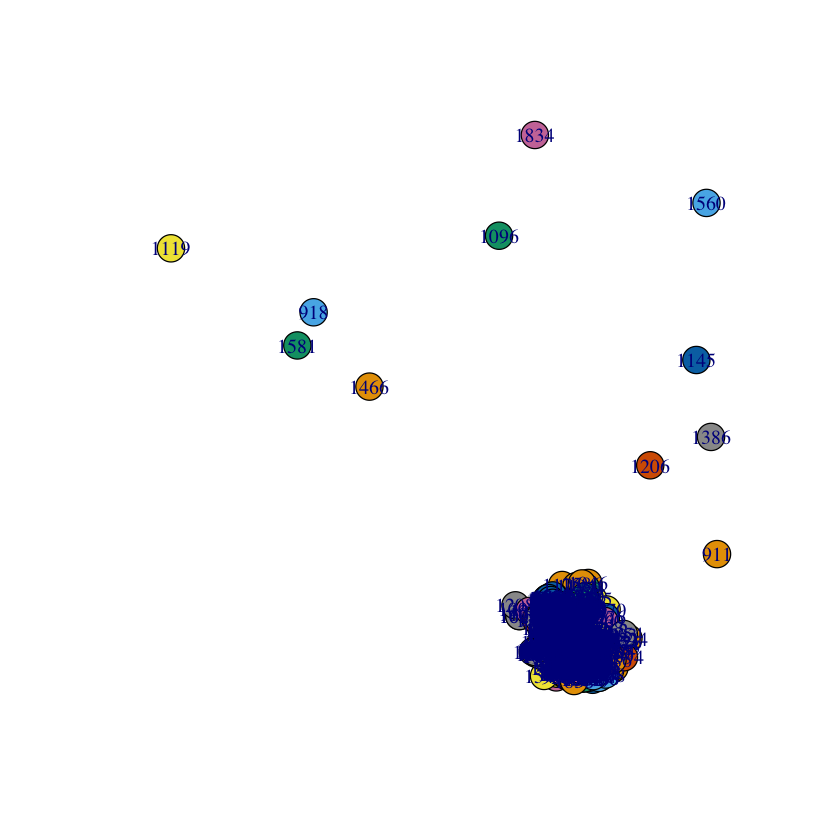

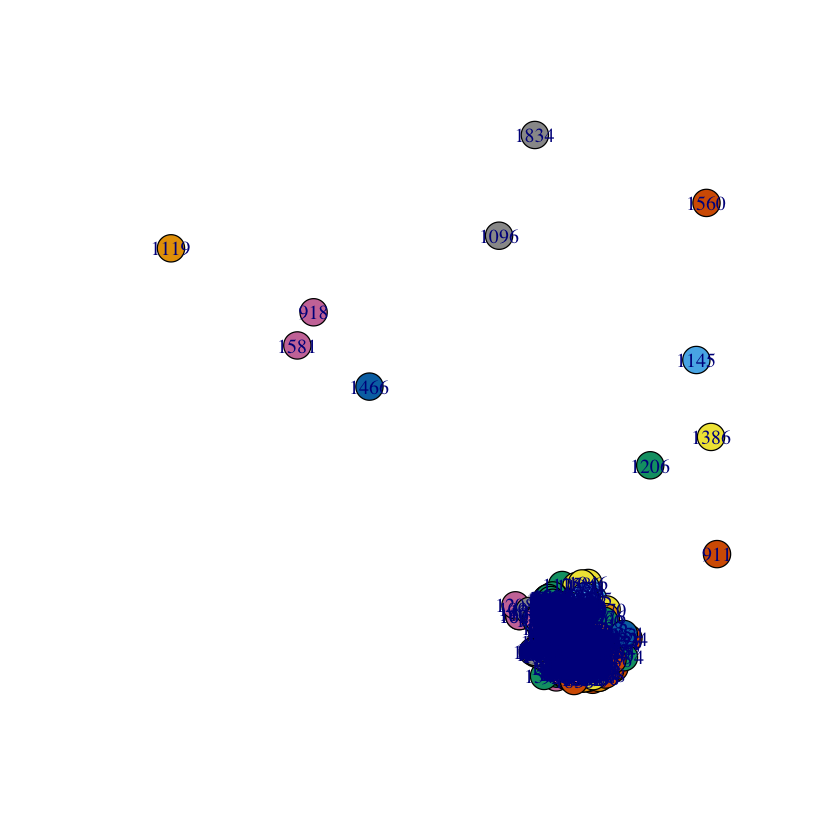

In [50]:
community_structure2(g,108)

Node ID: 349, cluster_fast_greedy, modularity=0.245692 
Node ID: 349, cluster_edge_betweenness, modularity=0.150566 


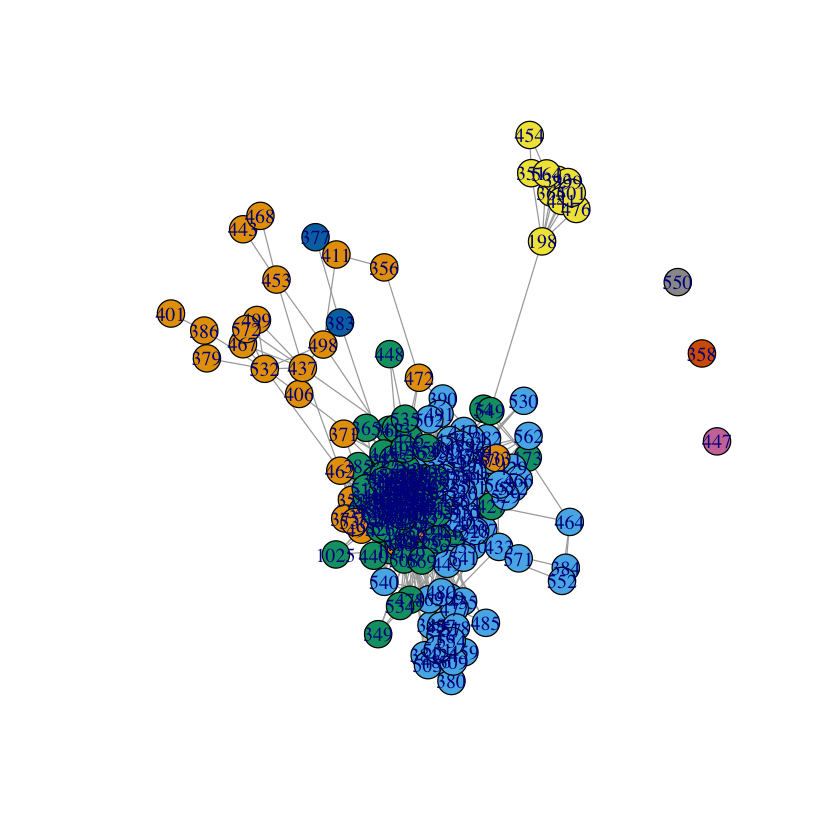

Node ID: 349, cluster_infomap, modularity=0.244816 


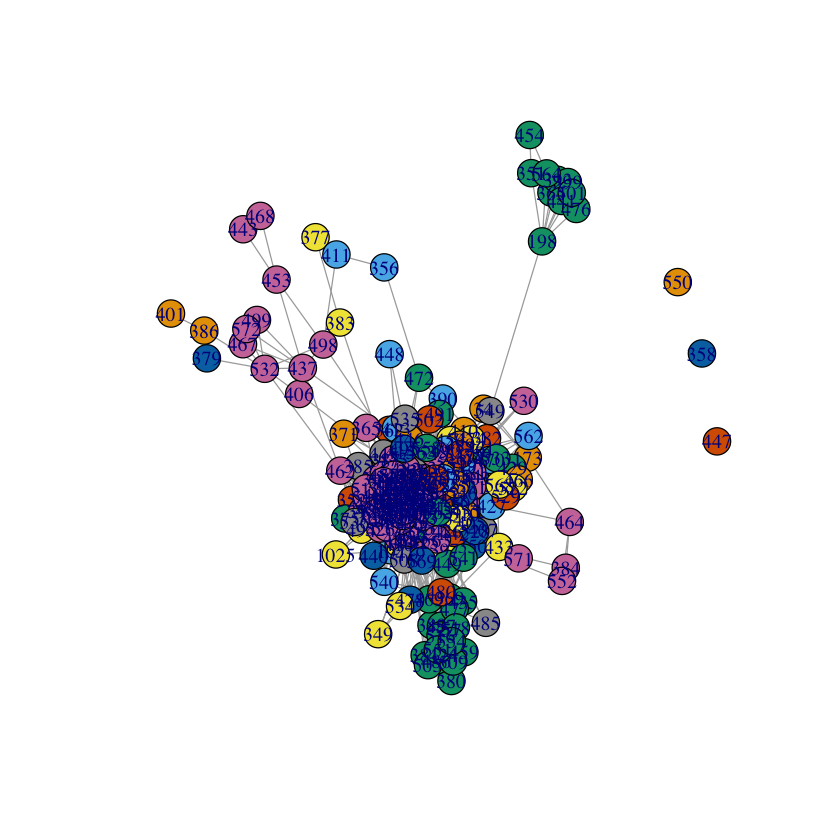

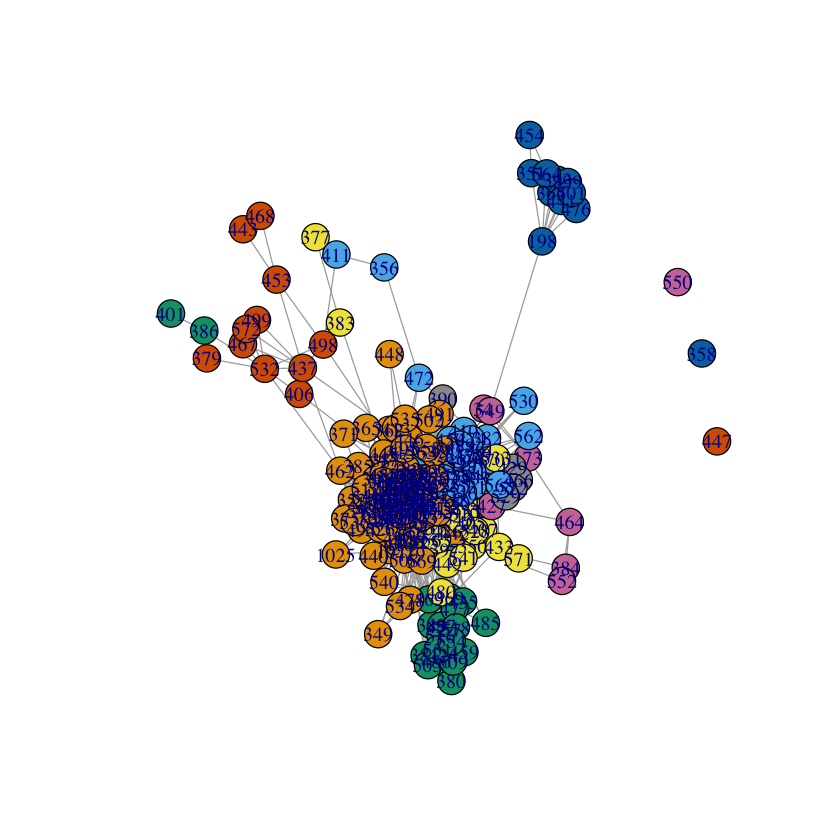

In [43]:
community_structure2(g,349)

Node ID: 484, cluster_fast_greedy, modularity=0.534214 
Node ID: 484, cluster_edge_betweenness, modularity=0.515441 


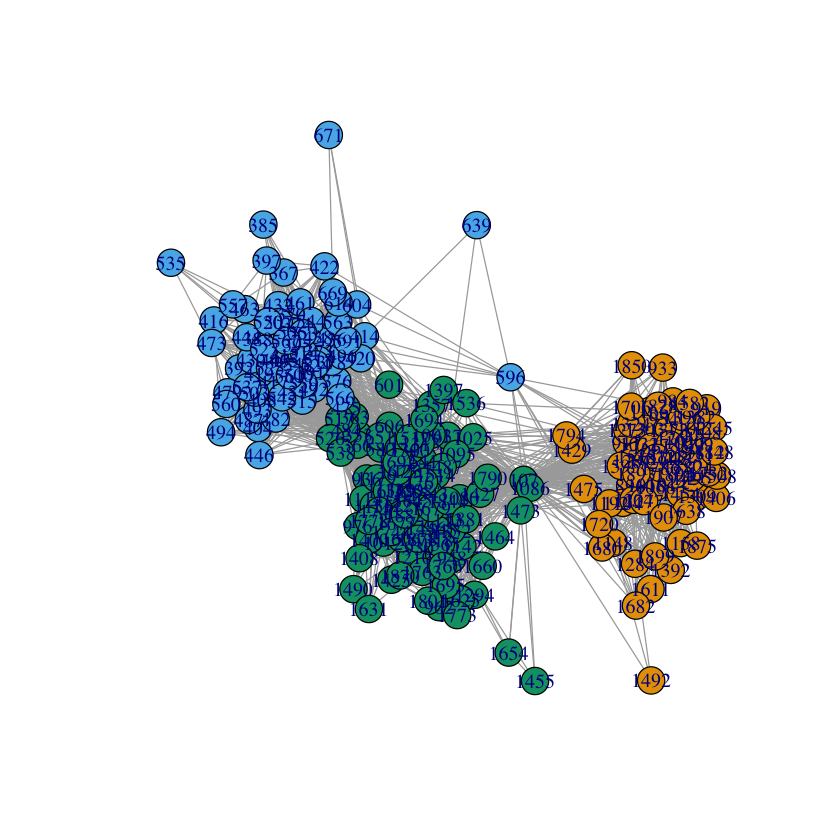

Node ID: 484, cluster_infomap, modularity=0.543444 


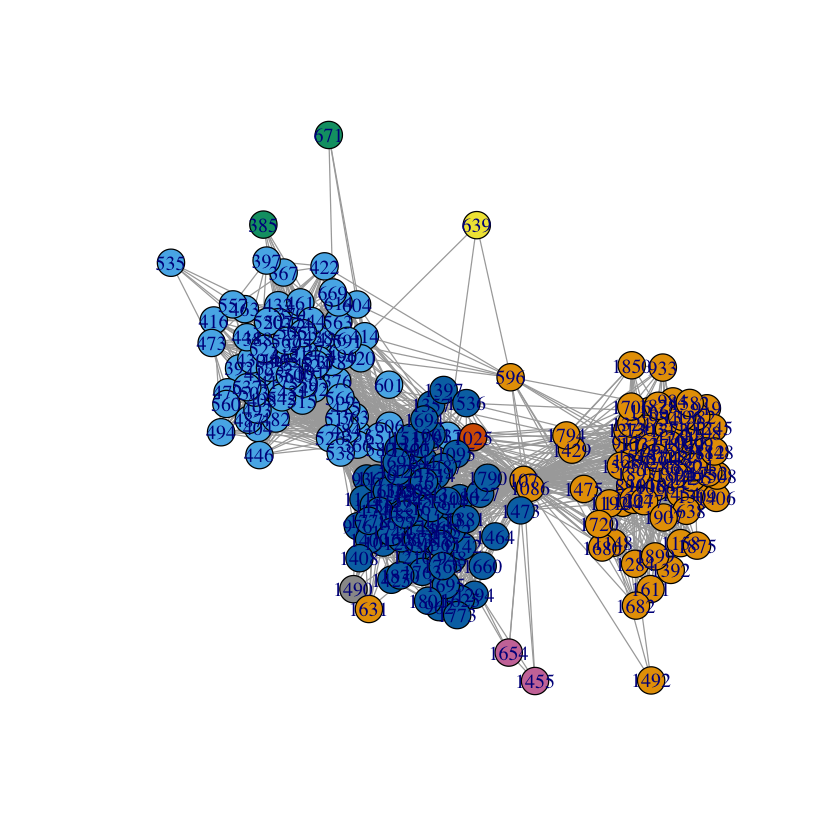

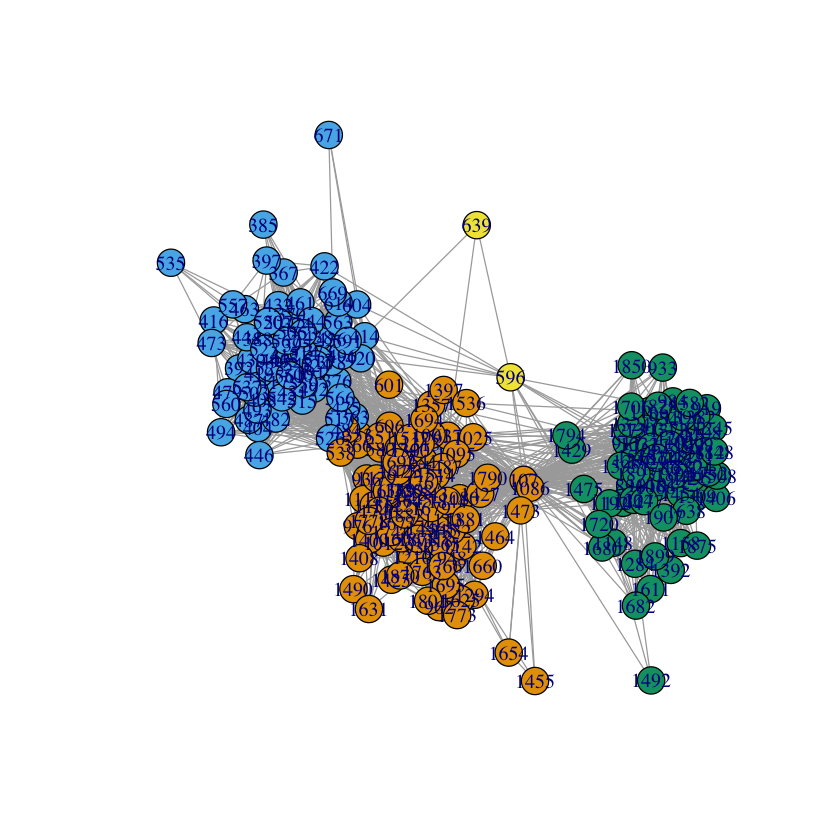

In [49]:
community_structure2(g,484)

Node ID: 1087, cluster_fast_greedy, modularity=0.148196 
Node ID: 1087, cluster_edge_betweenness, modularity=0.032495 


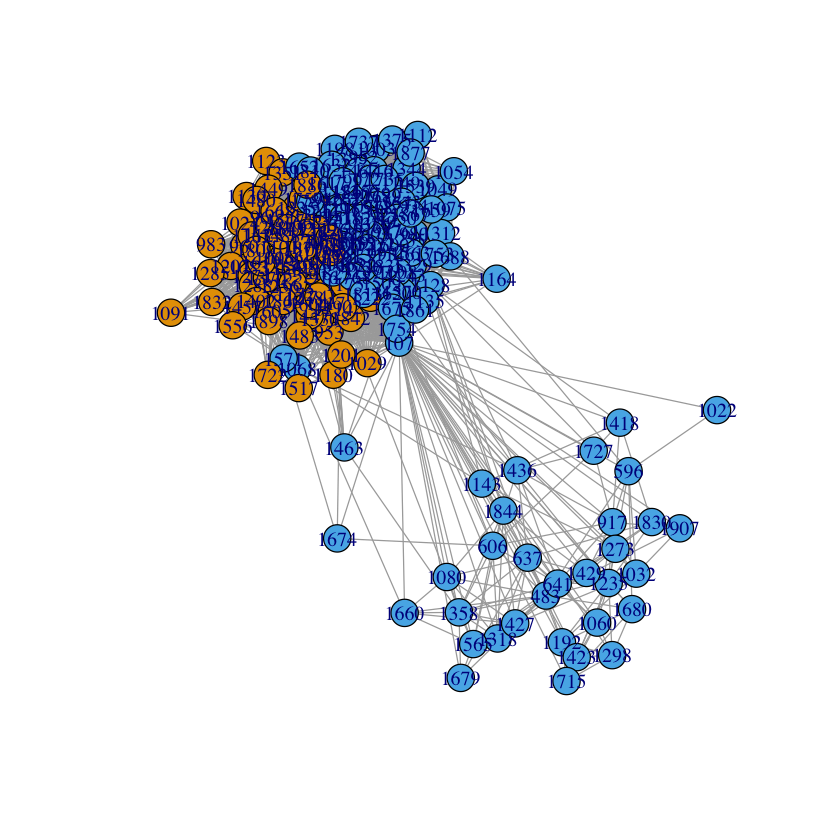

Node ID: 1087, cluster_infomap, modularity=0.027372 


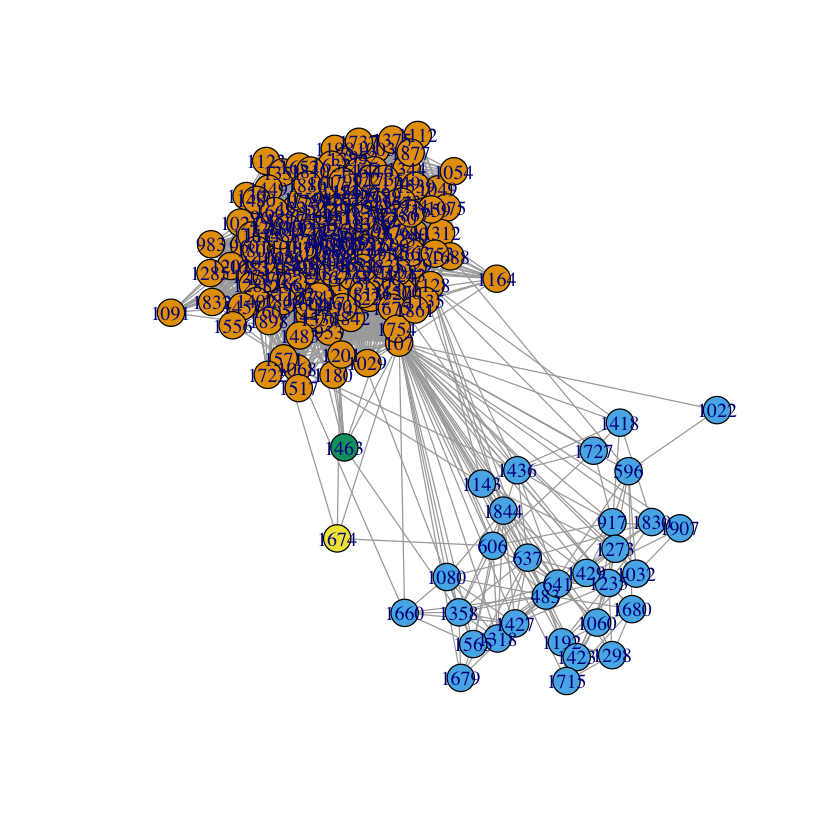

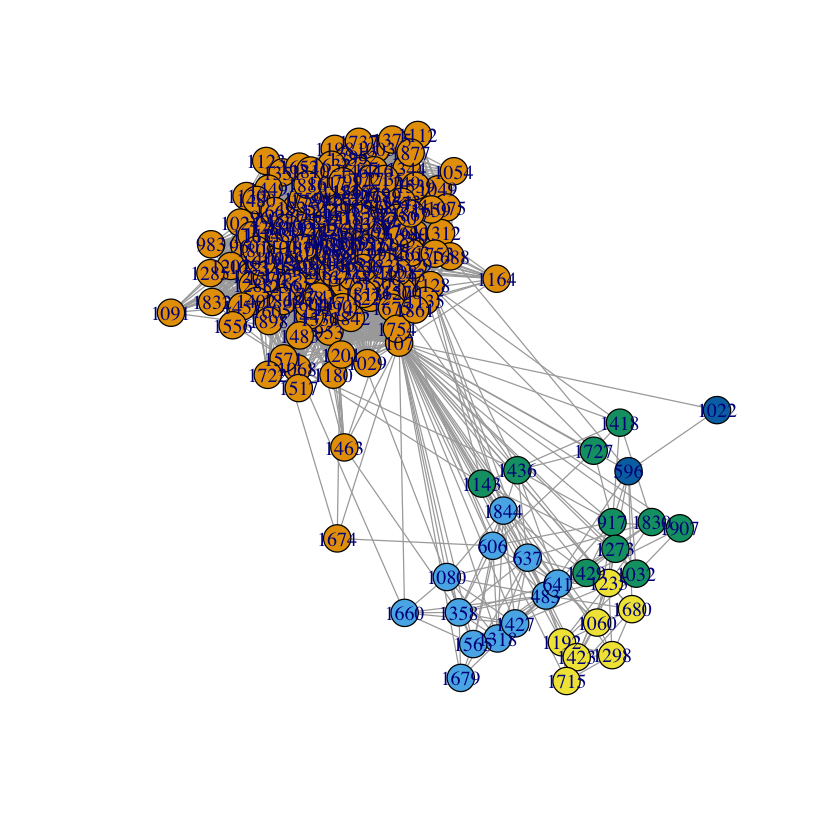

In [45]:
community_structure2(g,1087)

Modularity is higher when the core node in personalized network is removed. Because the sub group is more isolated when there is no bridge from core node to connect with each group.

## Question 11:

Embeddedness(u,v)=degree(g, v=v)-1, u is the core node, v is a non-core node
Embeddedness between the core node (u) and a non-core node (v) is defined as number of mutual connections shared by u and v, which is equal to the degree of v minus 1. Minus 1 is because we need to take off the connection between v and u when counting mutual friends.

## Question 12:

In [133]:
V(G1)
degree(G1)

+ 347/347 vertices, named, from e25eae5:
  [1] 1   2   3   4   5   6   7   8   9   10  13  14  16  17  19  20  21  22 
 [19] 23  24  25  26  27  28  29  30  31  32  33  34  35  36  38  39  40  41 
 [37] 44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61 
 [55] 62  63  64  65  66  67  68  69  70  71  72  73  75  76  77  78  79  80 
 [73] 81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98 
 [91] 99  100 101 102 103 104 105 106 107 108 109 110 111 112 113 115 116 117
[109] 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135
[127] 136 137 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
[145] 155 156 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
[163] 174 175 176 177 178 180 181 182 184 185 186 187 188 189 190 192 193 194
+ ... omitted several vertices

1   2   3   4   5   6   7   8   9  10  13  14  16  17  19  20  21  22  23  24 
 16   9  16   9  12   5  19   7  56   9  30  14   8  12  15  14  64  10  16  15 
 25  26  27  28  29  30  31  32  33  34  35  36  38  39  40  41  44  45  46  47 
 68  67   4  12  12  16  22   5   1   1   1  10   8  14  43  23   5  11   4   1 
 48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67 
 21   3  10   6   1  30   7  16  77  14   3  18   7   2  25   5   6  11  14  75 
 68  69  70  71  72  73  75  76  77  78  79  80  81  82  83  84  85  86  87  88 
  8   9   1   2  23   9  13   2   5   8  11  22   2  33   6  12  13   5  12  19 
 89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 
  7   1   7  20   7  21   5   8   2  48  12   8  18   5  15  31  13   7   2  12 
109 110 111 112 113 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 
 36   4  13   2  39  20  16   5  35  61   3  11  62  17   3   3   6  15  27   6 
130 131 132 133 134 135 136 137 139 140 141 142 143 144 145 146 147 148 149 150 
 15   6  15  17  18   9  21  15   8  10  27  42  11  14   1   9   5  19  13  10 
151 152 153 154 155 156 158 159 160 161 162 163 164 165 166 167 168 169 170 171 
  6   4   1   1   2  11  24  13   1  24   7   5   2  10   3   6  10  37  45   7 
172 173 174 175 176 177 178 180 181 182 184 185 186 187 188 189 190 192 193 194 
 40   5   3  16  13  10  12  19   9   2  17  25  43  15  47   6   3   4   4  18 
195 196 197 198 199 200 201 202 203 204 206 207 208 211 212 213 214 216 217 218 
  8  12  15   1  46  56   3   3  56  21   3   2   6  29  17  38  16   1   7   8 
219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 236 238 239 242 
  5   3   7  10  26  27   9  13  14   2   5   8  20  24   1   1  36  22  58  23 
243 244 245 246 248 249 250 251 252 254 257 258 259 260 261 262 263 265 266 268 
  7   1   4  13  20  23   4  13  64  16  17  14   7   7  37   3   6  26  17  10 
269 271 272 273 274 275 276 277 280 281 284 285 288 290 291 297 299 300 301 302 
  5  72  44   8  13   9  17  64  42  15  15  46   3  13  35  24  19   6   2  19 
303 304 305 306 308 309 310 311 312 313 314 315 318 319 320 322 323 324 325 326 
 20  54   1   8  23   9  12   6  25  36  12  55  10   7  20  71  38  25  38  18 
329 330 331 333 334 339  11  12  15  18  37  42  43  74 114 138 157 179 183 191 
 29  15  19   7  27  26   0   0   0   0   0   1   0   0   0   1   2   2   1   2 
205 209 210 215 235 237 240 241 247 253 255 256 264 267 270 278 279 282 283 286 
  1   0   0   0   4   6   2   1   2   2   1   1   4   1   3   9   1   1   4   1 
287 289 292 293 294 295 296 298 307 316 317 321 327 328 332 335 336 337 338 340 
  0   3   0   2   2   9   6  10   3   1   6   2   3   8  42   0   2   8   6   5 
341 342 343 344 345 346 347 
 11  33  17   8  15  26   6

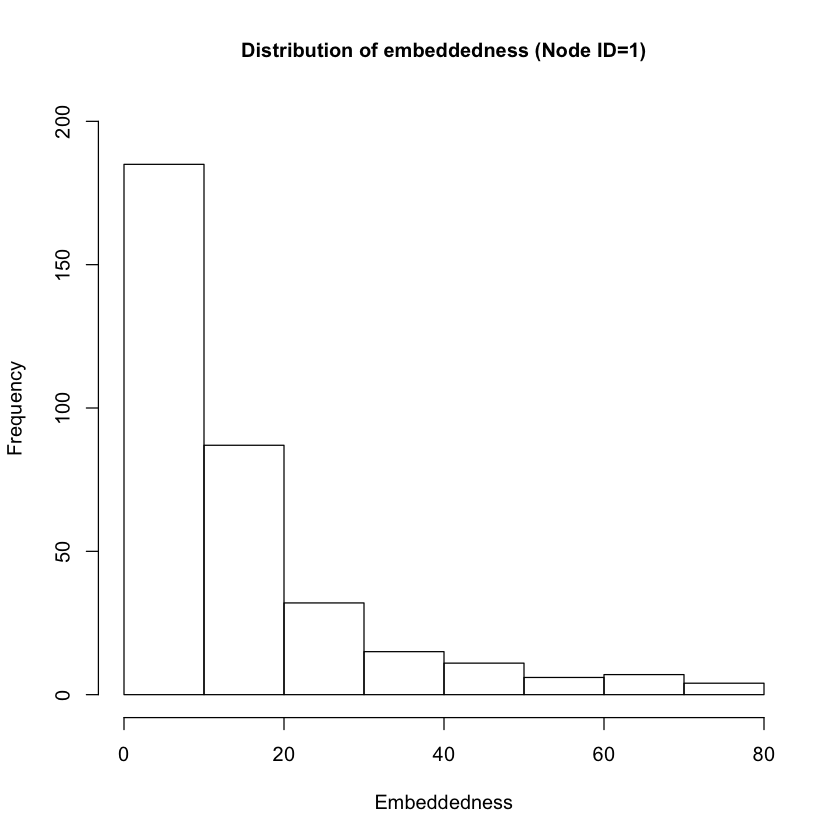

In [293]:
id=1
hist(degree(G1), ylim=c(0,200), main= paste0("Distribution of embeddedness (Node ID=", id, ")"), 
     cex.main=1, xlab='Embeddedness', ylab='Frequency')

In [141]:
id=11
gg349=make_ego_graph(g, order=1, nodes=V(g)[name == (id-1)], mode="all")[[1]]
GG349=gg349-V(gg349)[name==(id-1)]
V(gg349)
V(GG349)
degree(gg349)
degree(GG349)
ego(GG349, order=1, nodes=V(GG349)[name==67])

+ 11/11 vertices, named, from e7f58e4:
 [1] 0   10  67  142 169 200 277 285 291 323 332

+ 10/10 vertices, named, from b93faa4:
 [1] 0   67  142 169 200 277 285 291 323 332

0  10  67 142 169 200 277 285 291 323 332 
 10  10   9   9   7   8  10   8   5   8  10

0  67 142 169 200 277 285 291 323 332 
  9   8   8   6   7   9   7   4   7   9

[[1]]
+ 9/10 vertices, named, from b93faa4:
[1] 67  0   142 169 200 277 285 323 332


In [259]:
i=3
v_id=V(GG349)[i]
v_id
V(GG349)[name==v_id] 
V(GG349)[i] 
GG349_rv=GG349-V(GG349)[i] 
degree(GG349_rv)

+ 1/10 vertex, named, from b93faa4:
[1] 142

+ 0/10 vertices, named, from b93faa4:

+ 1/10 vertex, named, from b93faa4:
[1] 142

0  67 169 200 277 285 291 323 332 
  8   7   5   6   8   6   4   6   8

In [211]:
ego(GG349, order = 1, nodes=V(GG349)[name == 67])
V(GG349_rv)[name==67]

[[1]]
+ 9/10 vertices, named, from b93faa4:
[1] 67  0   142 169 200 277 285 323 332


+ 0/9 vertices, named, from c074007:

In [212]:
nei=neighbors(GG349, v=V(GG349)[name==67], mode = "all")
nei
nei=neighbors(GG349, v=i, mode = "all")
nei

+ 8/10 vertices, named, from b93faa4:
[1] 0   142 169 200 277 285 323 332

+ 8/10 vertices, named, from b93faa4:
[1] 0   142 169 200 277 285 323 332

In [213]:
combn(nei, 2)
dim(combn(nei, 2))
ncol(combn(nei, 2))

1,1,1,1,1,1,1,3,3,3,⋯,5,5,5,5,6,6,6,7,7,9
3,4,5,6,7,9,10,4,5,6,⋯,6,7,9,10,7,9,10,9,10,10


[1]  2 28

[1] 28

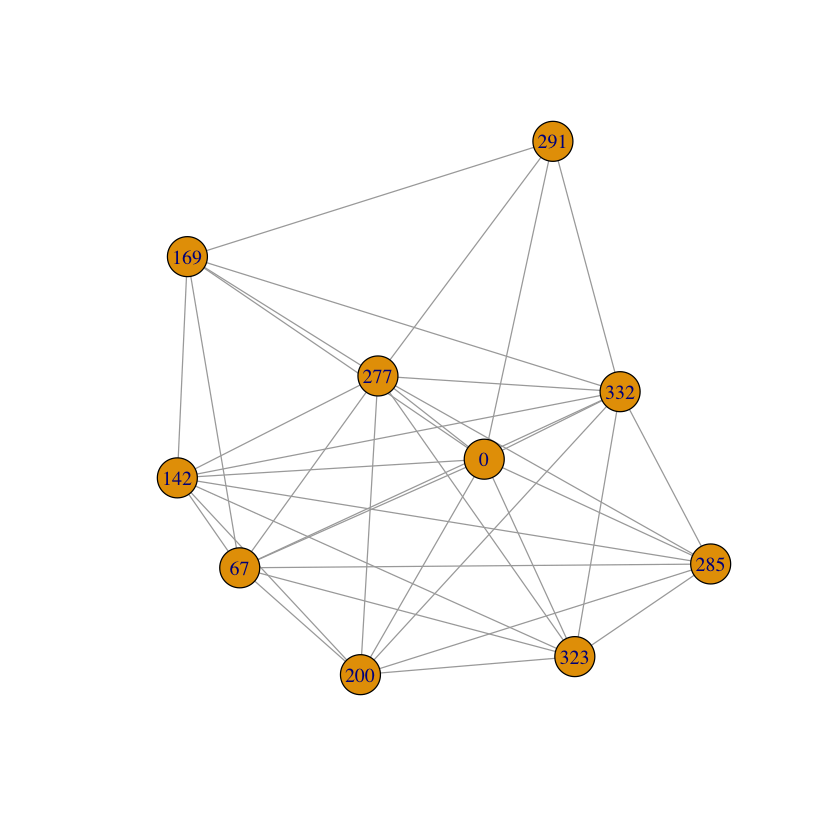

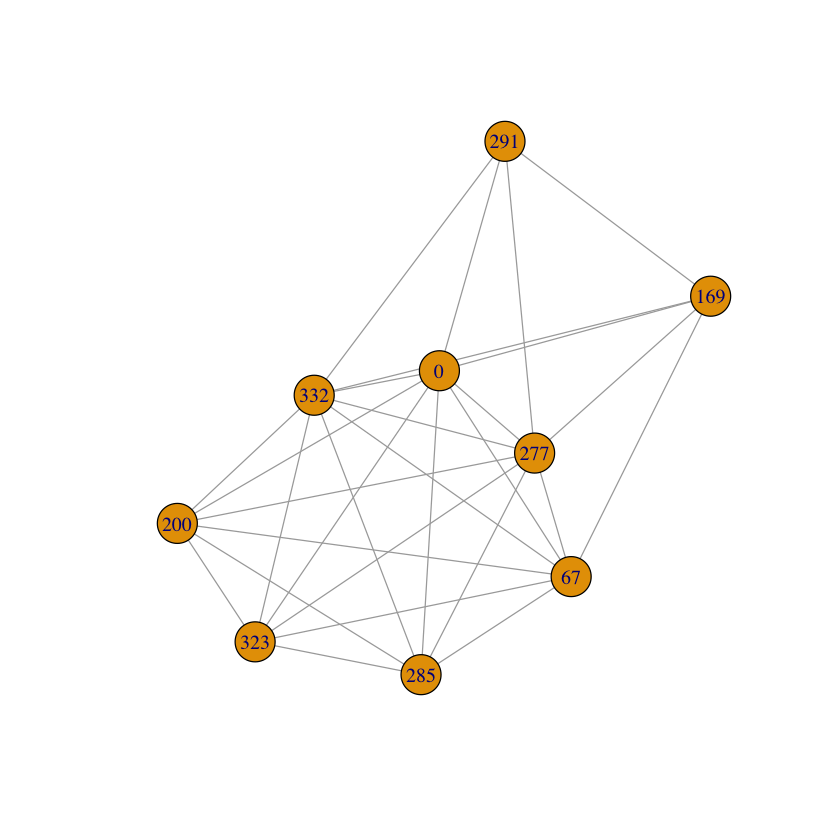

In [260]:
plot(GG349)
plot(GG349_rv)

In [261]:
i=3
nei=neighbors(GG349, v=i, mode = "all")
dist=c()
for (n in (1:ncol(combn(nei, 2)))){
    s=combn(nei, 2)[1,n]
    v_s=as_ids(V(GG349)[s])
    e=combn(nei, 2)[2,n]
    v_e=as_ids(V(GG349)[e])
    dist[[n]]=distances(GG349_rv, v=V(GG349_rv)[name==v_s], to=V(GG349_rv)[name==v_e])
    #print(dist[[n]])
    if ((dist[[n]]>=2)|(is.finite(dist[[n]])==FALSE)){
        dist[[n]]=1
    }
    else{
        dist[[n]]=0
    }   
}
dist
sum(dist)

[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 2
[1] 1
[1] 2
[1] 2
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1
[1] 1


[1] 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0

[1] 3

In [19]:
neighbors(G1, v=31, mode = "all")

+ 1/347 vertex, named, from ec3f978:
[1] 143

In [6]:
id=1
set.seed(0)
#g1=make_ego_graph(g, order=1, nodes=V(g)[name == (id-1)], mode="all")[[1]]
g1=make_ego_graph(g, order=1, '0', mode="all")[[1]] 
G1 = g1-V(g1)[name==(id-1)] #remove core node
sum_dist=c()
for (iv in (1:vcount(G1))){
    G1_rv=G1-V(G1)[iv] #remove the node whose dispersion is being computed
    nei=neighbors(G1, v=iv, mode = "all") #find neighbors for dispersion node
    dist=c()
    if (length(nei)<2){
        next #if less than 2 neighbors, skip dispersion calculation
    }
    else{
        comb=combn(nei, 2)
        for (n in (1:ncol(comb))){
            s=comb[1,n]
            v_s=as_ids(V(G1)[s]) #as_ids convert igraph objec to normal vector
            e=comb[2,n]
            v_e=as_ids(V(G1)[e])
            dist[[n]]=distances(G1_rv, v=V(G1_rv)[name==v_s], to=V(G1_rv)[name==v_e])
            if ((dist[[n]]>2)|(is.finite(dist[[n]])==FALSE)){
                dist[[n]]=1
            }
            else{
                dist[[n]]=0
            }   
        }        
    }
    #print(dist)
    sum_dist[[iv]]=sum(dist)
}
print(sum_dist)

  [1]  20   0  16   0  25   0   2   0  16   0   0   0   0   0  79   0 201   2
 [19] 110   0 483   9   0   0  13   1  35   0  NA  NA  NA   0   4   0  96  16
 [37]   0   0   0  NA  28   3   1   0  NA  92   1   0  89   7   1   0   0   1
 [55]   7   0   0   3   0  64   0   0  NA   0   3   2   0   0   2   0   0  20
 [73]   1  21   0   9   0   0   0  29   0  NA   0   0   0  11   0   8   0   7
 [91]   0   0   2   0   0   4   0   1   0   0  17   0  12   0   4  19   2   0
[109]  21 459   2  10  79   0   2   0   1   0   7   0  16   0  12  17   0   0
[127]  21  15   0   0   3   0  11   1  NA   8   0   4   0   0   0   3  NA  NA
[145]   0   8  17   7  NA   5   0   6   0   0   2   0   0  34  63   9  22   8
[163]   0  26   0   0  10   1   0   0   0   6  15   0  17   0   3   6   3   0
[181]   0  12   0  NA  19  13   0   2  45  15   2   0   0   0   1  67   9  NA
[199]   0   0   4   0   0   9   1   3   0   0   1   0   4  23  11   0  NA  NA
[217]  16   8  79  20   6  NA   3   2   7  31   0   0  34   0   

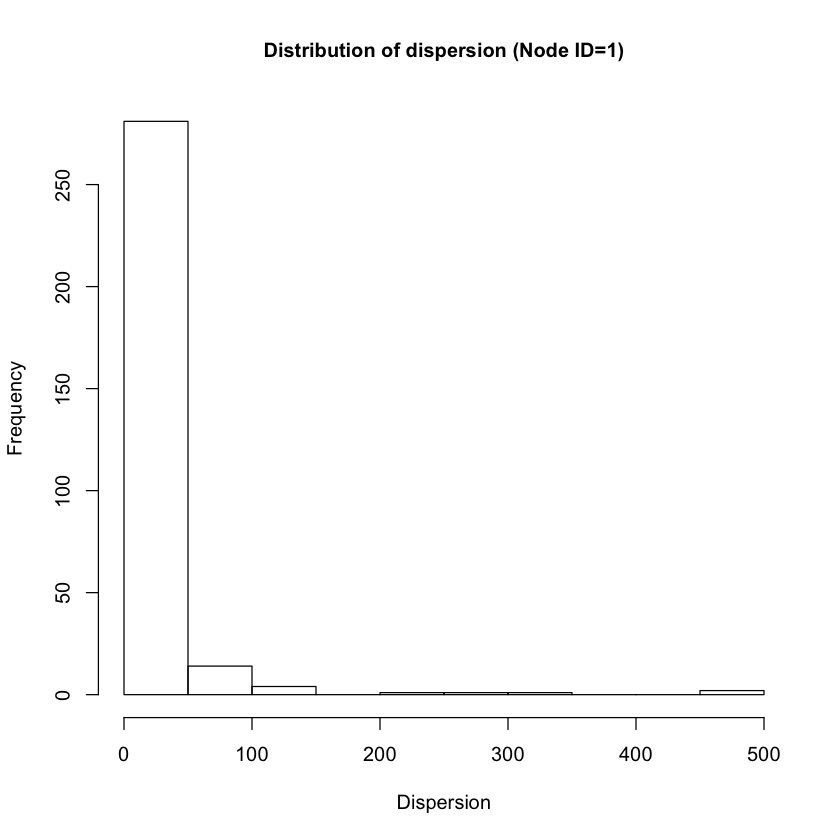

In [7]:
id=1
hist(sum_dist, main = paste0("Distribution of dispersion (Node ID=", id, ")"),
     cex.main=1, xlab='Dispersion', ylab='Frequency')

In [26]:
emb_disp_hist= function(g, id){
    set.seed(0)
    gg=make_ego_graph(g, order=1, nodes=V(g)[name == (id-1)], mode="all")[[1]]
    GG = gg -V(gg)[name==(id-1)] #remove core node
    sum_dist=c()
    for (iv in (1:vcount(GG))){
        GG_rv =GG -V(GG)[iv] #remove the node whose dispersion is being computed
        nei=neighbors(GG, v=iv, mode = "all") #find neighbors for dispersion node
        dist=c()
        if (length(nei)<2){
            next
        }
        else{
            comb=combn(nei, 2)
            for (n in (1:ncol(comb))){
                s=comb[1,n]
                v_s=as_ids(V(GG)[s]) #as_ids convert igraph objec to normal vector
                e=comb[2,n]
                v_e=as_ids(V(GG)[e])
                dist[[n]]=distances(GG_rv, v=V(GG_rv)[name==v_s], to=V(GG_rv)[name==v_e])
                if ((dist[[n]]>2)|(is.finite(dist[[n]])==FALSE)){
                    dist[[n]]=1
                }
                else{
                    dist[[n]]=0
                }   
            }        
        }
        #print(dist)
        sum_dist[[iv]]=sum(dist)
    }
    print(sum_dist)
    emb_disp <- list("emb" = degree(GG), "disp" = sum_dist)
    
    hist(degree(GG), main= paste0("Distribution of embeddedness (Node ID=", id, ")"), 
         cex.main=1, xlab='Embeddedness', ylab='Frequency')
    hist(sum_dist, main = paste0("Distribution of dispersion (Node ID=", id, ")"),
         cex.main=1, xlab='Dispersion', ylab='Frequency')
    return(emb_disp) 
}

  [1]  20   0  16   0  25   0   2   0  16   0   0   0   0   0  79   0 201   2
 [19] 110   0 483   9   0   0  13   1  35   0  NA  NA  NA   0   4   0  96  16
 [37]   0   0   0  NA  28   3   1   0  NA  92   1   0  89   7   1   0   0   1
 [55]   7   0   0   3   0  64   0   0  NA   0   3   2   0   0   2   0   0  20
 [73]   1  21   0   9   0   0   0  29   0  NA   0   0   0  11   0   8   0   7
 [91]   0   0   2   0   0   4   0   1   0   0  17   0  12   0   4  19   2   0
[109]  21 459   2  10  79   0   2   0   1   0   7   0  16   0  12  17   0   0
[127]  21  15   0   0   3   0  11   1  NA   8   0   4   0   0   0   3  NA  NA
[145]   0   8  17   7  NA   5   0   6   0   0   2   0   0  34  63   9  22   8
[163]   0  26   0   0  10   1   0   0   0   6  15   0  17   0   3   6   3   0
[181]   0  12   0  NA  19  13   0   2  45  15   2   0   0   0   1  67   9  NA
[199]   0   0   4   0   0   9   1   3   0   0   1   0   4  23  11   0  NA  NA
[217]  16   8  79  20   6  NA   3   2   7  31   0   0  34   0   

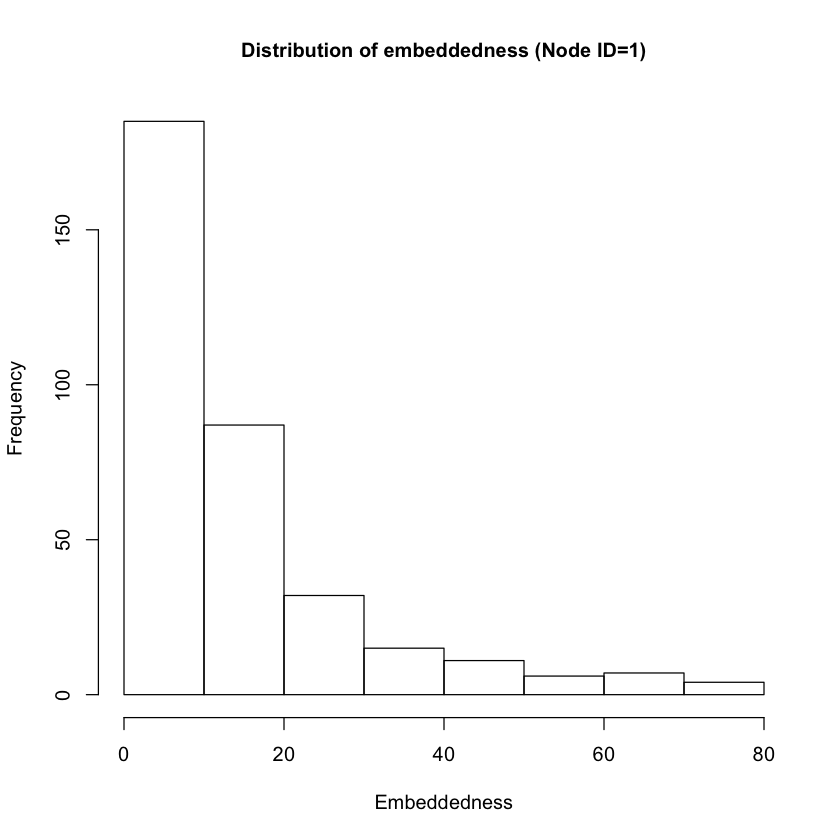

$emb
  1   2   3   4   5   6   7   8   9  10  13  14  16  17  19  20  21  22  23  24 
 16   9  16   9  12   5  19   7  56   9  30  14   8  12  15  14  64  10  16  15 
 25  26  27  28  29  30  31  32  33  34  35  36  38  39  40  41  44  45  46  47 
 68  67   4  12  12  16  22   5   1   1   1  10   8  14  43  23   5  11   4   1 
 48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67 
 21   3  10   6   1  30   7  16  77  14   3  18   7   2  25   5   6  11  14  75 
 68  69  70  71  72  73  75  76  77  78  79  80  81  82  83  84  85  86  87  88 
  8   9   1   2  23   9  13   2   5   8  11  22   2  33   6  12  13   5  12  19 
 89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 
  7   1   7  20   7  21   5   8   2  48  12   8  18   5  15  31  13   7   2  12 
109 110 111 112 113 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 
 36   4  13   2  39  20  16   5  35  61   3  11  62  17   3   3   6  15  27   6 
130 131 132 133 134 135 136 137 139 140 141 142 143 144 145 146 147 148 149 150 
 15   6  15  17  18   9  21  15   8  10  27  42  11  14   1   9   5  19  13  10 
151 152 153 154 155 156 158 159 160 161 162 163 164 165 166 167 168 169 170 171 
  6   4   1   1   2  11  24  13   1  24   7   5   2  10   3   6  10  37  45   7 
172 173 174 175 176 177 178 180 181 182 184 185 186 187 188 189 190 192 193 194 
 40   5   3  16  13  10  12  19   9   2  17  25  43  15  47   6   3   4   4  18 
195 196 197 198 199 200 201 202 203 204 206 207 208 211 212 213 214 216 217 218 
  8  12  15   1  46  56   3   3  56  21   3   2   6  29  17  38  16   1   7   8 
219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 236 238 239 242 
  5   3   7  10  26  27   9  13  14   2   5   8  20  24   1   1  36  22  58  23 
243 244 245 246 248 249 250 251 252 254 257 258 259 260 261 262 263 265 266 268 
  7   1   4  13  20  23   4  13  64  16  17  14   7   7  37   3   6  26  17  10 
269 271 272 273 274 275 276 277 280 281 284 285 288 290 291 297 299 300 301 302 
  5  72  44   8  13   9  17  64  42  15  15  46   3  13  35  24  19   6   2  19 
303 304 305 306 308 309 310 311 312 313 314 315 318 319 320 322 323 324 325 326 
 20  54   1   8  23   9  12   6  25  36  12  55  10   7  20  71  38  25  38  18 
329 330 331 333 334 339  11  12  15  18  37  42  43  74 114 138 157 179 183 191 
 29  15  19   7  27  26   0   0   0   0   0   1   0   0   0   1   2   2   1   2 
205 209 210 215 235 237 240 241 247 253 255 256 264 267 270 278 279 282 283 286 
  1   0   0   0   4   6   2   1   2   2   1   1   4   1   3   9   1   1   4   1 
287 289 292 293 294 295 296 298 307 316 317 321 327 328 332 335 336 337 338 340 
  0   3   0   2   2   9   6  10   3   1   6   2   3   8  42   0   2   8   6   5 
341 342 343 344 345 346 347 
 11  33  17   8  15  26   6 

$disp
  [1]  20   0  16   0  25   0   2   0  16   0   0   0   0   0  79   0 201   2
 [19] 110   0 483   9   0   0  13   1  35   0  NA  NA  NA   0   4   0  96  16
 [37]   0   0   0  NA  28   3   1   0  NA  92   1   0  89   7   1   0   0   1
 [55]   7   0   0   3   0  64   0   0  NA   0   3   2   0   0   2   0   0  20
 [73]   1  21   0   9   0   0   0  29   0  NA   0   0   0  11   0   8   0   7
 [91]   0   0   2   0   0   4   0   1   0   0  17   0  12   0   4  19   2   0
[109]  21 459   2  10  79   0   2   0   1   0   7   0  16   0  12  17   0   0
[127]  21  15   0   0   3   0  11   1  NA   8   0   4   0   0   0   3  NA  NA
[145]   0   8  17   7  NA   5   0   6   0   0   2   0   0  34  63   9  22   8
[163]   0  26   0   0  10   1   0   0   0   6  15   0  17   0   3   6   3   0
[181]   0  12   0  NA  19  13   0   2  45  15   2   0   0   0   1  67   9  NA
[199]   0   0   4   0   0   9   1   3   0   0   1   0   4  23  11   0  NA  NA
[217]  16   8  79  20   6  NA   3   2   7  31   0   0  34   0   7   0   0  10
[235]  13   0   0   4   0   0   6  41 125   0   1   0   0 319  59   0   0  84
[253]   0   0  42   0   5   0   1   0   1  84  NA   0   8   0   6   1  39  31
[271] 

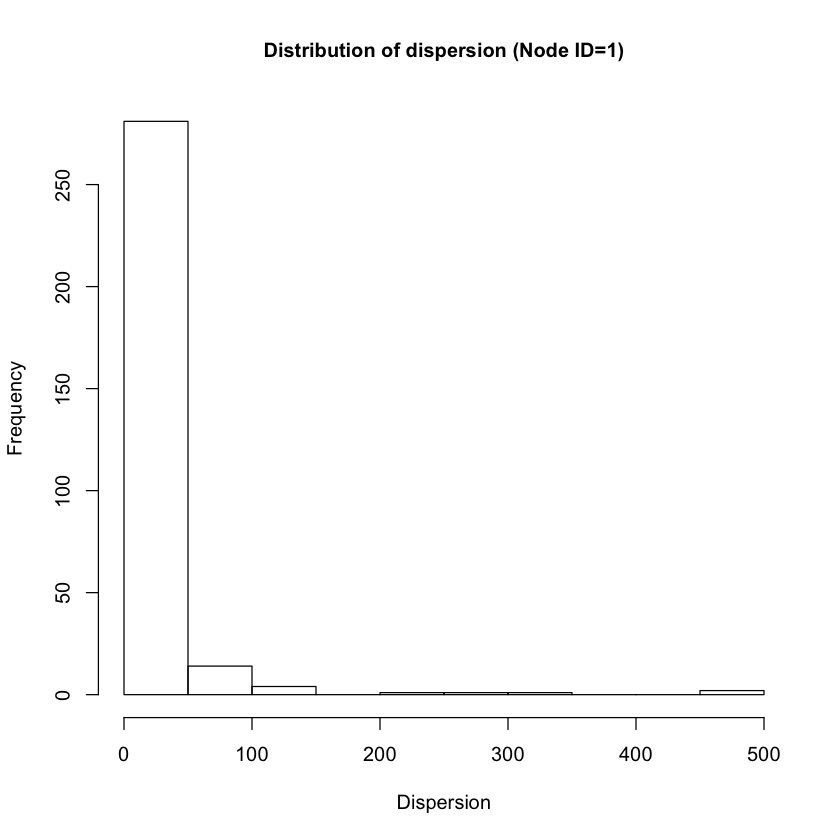

In [41]:
emb_disp1=emb_disp_hist(g, 1)
emb_disp1

   [1]    0    0   21    6   81   14   33   16   24   17    9   44    3 4804
  [15]  248   27  674    2   61   11   15  125    1  453    1  769  184    2
  [29]  132   50   62    0    0   27    0    0    0    1   11    0   21   50
  [43]    9    0    9  105    0   46  159 2268    0   16  104    4    0   72
  [57]   26    4  137    0    0    0    2   12    2   75    2    1    0    0
  [71]   15    7   52    2    3    2    0   52  122    8    0    0   35    0
  [85]   29   34    0    6    1    0    0   70   23   29    0   26    0    3
  [99]   28  104    0    1    0    0   20    0    1    0   12   99    0   18
 [113]    0  119    0    0    0    0    7    0    0    3   49    0  130   55
 [127]  143    1    0    0    1    2  107    0   98    3    0   14   19    9
 [141]    2   28    0   53   22  102    0    0  147    0    2   47   48    0
 [155]   10   13   14   16    0    0  257   14    0    5    1    0   17    0
 [169]   22    1    0    0   21    1    9    0   17    0    8   94  122    9

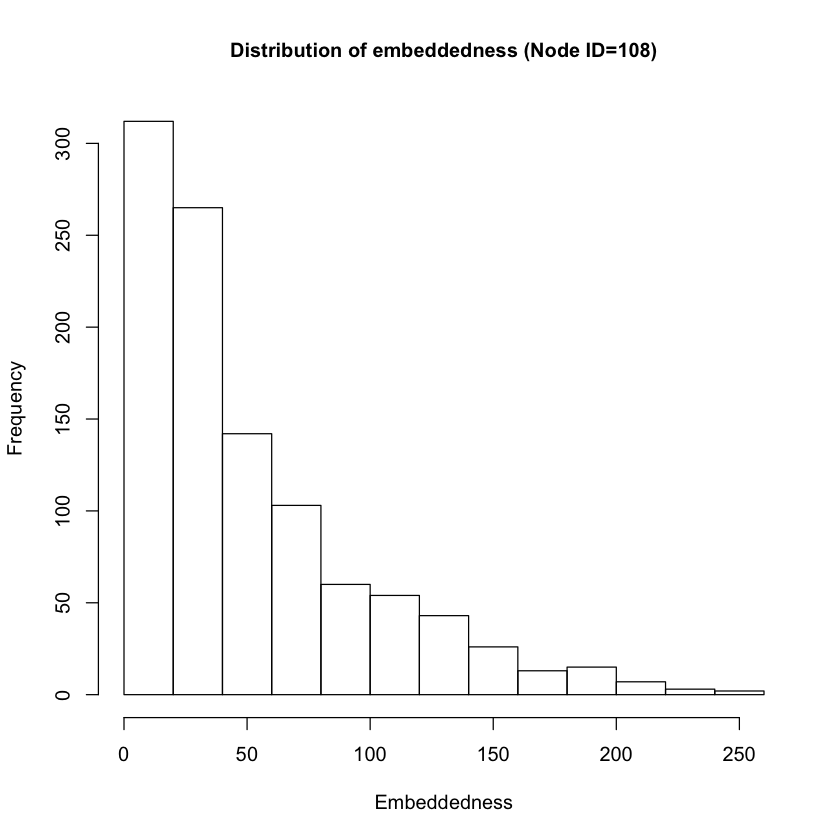

$emb
   0   58  171  348  353  363  366  376  389  414  420  428  475  483  484  517 
   2    3   10   17   61   52   58   32   28   17   13   41   40  166   67   43 
 526  538  563  566  580  596  601  606  629  637  641  649  651  896  897  898 
  76   44   19   34   62   28   14   71    9   91   56    3   51  125   65   37 
 899  900  901  902  903  904  905  906  907  908  909  910  912  913  914  915 
   2   12   33   45   33    2   16   77   12   31   11    4    8   43   15   34 
 916  917  919  920  921  922  923  924  925  926  927  928  929  930  931  932 
 146  129   28   12  105   29    7   44  166   20   74    8    4   51   14   62 
 933  934  935  936  937  938  939  940  941  942  943  944  945  946  947  948 
  24   81    6   36    6   28   16   16   53   64   11   36    3  165  114   37 
 949  950  951  952  953  954  955  956  957  958  959  960  961  962  963  964 
  22    9   19   83  108   54    9    9   64   23   45  102   12   26   32   25 
 965  966  967  968  969  970  971  972  973  974  975  976  977  978  979  980 
  15  114  106   39   31   14   33   20   17   10   53   23   25  103    9  127 
 981  982  983  984  985  986  987  988  989  990  991  992  993  994  995  996 
  46   67   61   41    6   10    5   40   34   11   18   30  153   26   65    3 
 997  998  999 1000 1001 1002 1003 1004 1005 1006 1007 1008 1009 1010 1011 1012 
  95    8   76   15   38    3   94  119   13  141   15    7   56   35   31   31 
1013 1014 1015 1016 1017 1018 1019 1020 1021 1022 1023 1024 1025 1026 1027 1028 
  11   98   35    8  148   50   57   57   60    3    8   84   28   79    2   66 
1029 1030 1031 1032 1033 1034 1035 1036 1037 1038 1039 1040 1041 1042 1043 1044 
  78   10    3   78   16    2   25   57   36    4   26   66   47   14   11   27 
1045 1046 1047 1048 1049 1050 1051 1052 1053 1054 1055 1056 1057 1058 1059 1060 
  11    2   64  105   81   10   45   62    7   53   13   64    4    6  164   50 
1061 1062 1063 1064 1065 1066 1067 1068 1069 1070 1071 1072 1073 1074 1075 1076 
   9   21   21   26    1   67   75   48   20   77    2   25    9   62   79  141 
1077 1078 1079 1080 1081 1082 1083 1084 1085 1086 1087 1088 1089 1090 1091 1092 
  14  182  122   59   29   56  105   14   32  204    6   13   13   12   19   49 
1093 1094 1095 1097 1098 1099 1100 1101 1102 1103 1104 1105 1106 1107 1108 1109 
   8   10   23   35   22   55   63  122   50    7  108    3   26  140   42   37 
1110 1111 1112 1113 1114 1115 1116 1117 1118 1120 1121 1122 1123 1124 1125 1126 
  69    8   53   46   37   35   28  121   34   50   23   48   70  129  116  197 
1127 1128 1129 1130 1131 1132 1133 1134 1135 1136 1137 1138 1139 1140 1141 1142 
  20   97   59   65   31  141    5   10   67   32   28   13   23    8   17   32 
1143 1144 1146 1147 1148 1149 1150 1151 1152 1153 1154 1155 1156 1157 1158 1159 
  13   20  146    4   64  101   13    5   16  138    8   44   98    4   65   60 
1160 1161 1162 1163 1164 1165 1166 1167 1168 1169 1170 1171 1172 1173 1174 1175 
  87   18    7   99   26   25   56   27    5   18   35   20  112  114   17  131 
1176 1177 1178 1179 1180 1181 1182 1183 1184 1185 1186 1187 1188 1189 1190 1191 
   1   14   12   44   44   88   65   33  157  155   16   19   31   37   38  109 
1192 1193 1194 1195 1196 1197 1198 1199 1200 1201 1202 1203 1204 1205 1207 1209 
  96    8    3   48   25   14   82  216    3   57    8    7  106  101   71   75 
1210 1211 1212 1213 1214 1215 1216 1217 1218 1219 1220 1221 1222 1223 1225 1226 
  39  172   25   19  113   42   35   46   10   53    8   70  141   21   29   34 
1227 1228 1229 1230 1231 1232 1234 1235 1236 1237 1238 1239 1240 1241 1242 1243 
  83   22   46  124   73   28   14  106   42   59  151    8    6   19   92  111 
1244 1245 1246 1247 1248 1249 1250 1251 1252 1254 1255 1256 1257 1258 1259 1260 
  11   39   34   23    7   14  136   11    2    5  123  134   54   41   46   37 
1261 1262 1263 1264 1265 1266 1267 1268 1269 1270 1271 1272 1273 1274 1275 1276 
  67    1    5    4   30  

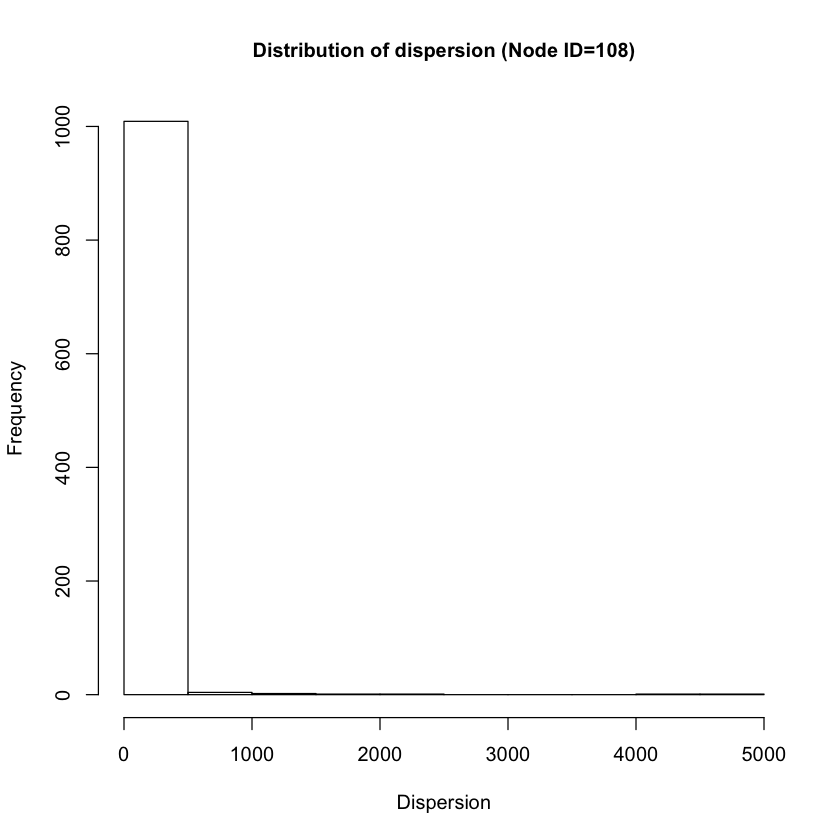

In [42]:
emb_disp108=emb_disp_hist(g, 108)
emb_disp108

  [1]   0   2   1   8   0  44   0   0   6   0   6   1   0  11   9   7   0   5
 [19]   0   0   3   4  11  38  11   0  19 105   5   0  84  NA  10  NA   0   0
 [37]   0   1   0   0   1  67   0   9   0   9   0   0   0   4   1 105   0   0
 [55]   3   0   0   7   7   2   7  11   1   0   1 207   0  67   0   0   0   4
 [73] 291   0  13   6   2   0   4   0   5  67   0   3  36  34   0  28   5  20
 [91]  11   2  12   2   0   0  NA  10   1   0   0   4   0   0  11   5   0  43
[109]   8   6   8   0 105   2  31  52   4   7   0   0  18   2   0   3   4   0
[127]  30   0   0   1   0   2   0   1  27   6   0   0   0   0   6   3   0   1
[145]   9   0   0  16  77   6   0  69   0   0   1  95   0   2  43  17   0  13
[163]   0   0  44   6   6   0   8   3   0   2   0   0   9   1   8   0   0   0
[181]   0  36  15   0   0   0   2  53   3   2  11   7   0  18   3   1   0   5
[199]   0   9   0  18   2   2   1   8   6  16 446   0  14   0   4  NA  NA  NA
[217]  NA   0   3   0  NA   0   0   0   4   0   5   0   0


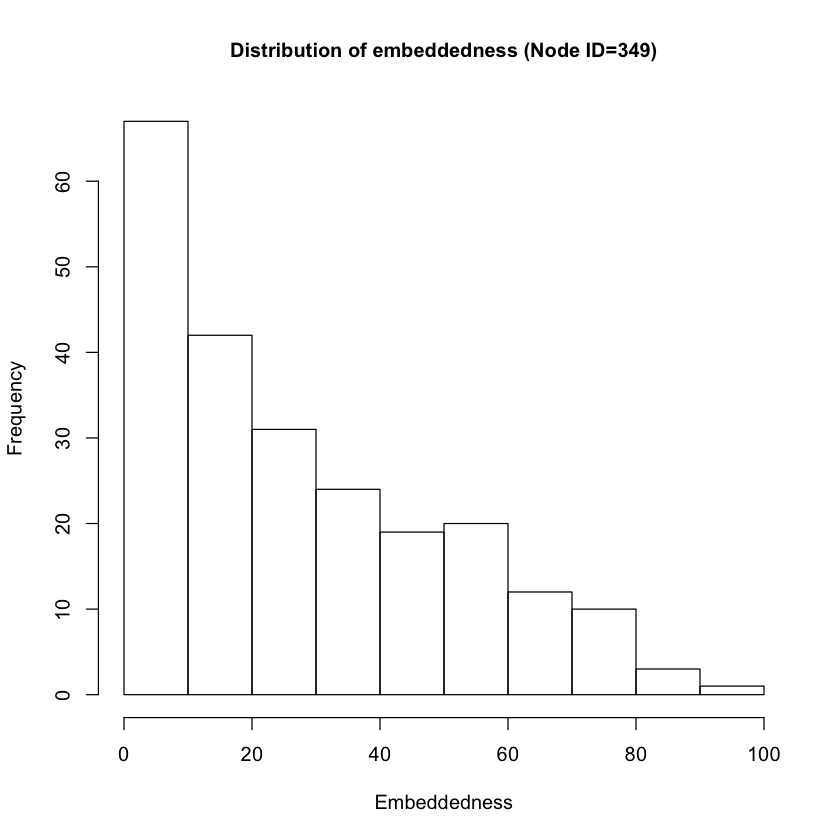

$emb
  34  107  173  198  349  350  351  352  353  354  355  356  357  359  360  361 
   3   17    5    9    4   20    4   22   53   25   38    2   17   25   42   22 
 362  363  364  365  366  367  368  369  370  371  372  373  374  375  376  377 
  18   52    8    5   50   31   33   25   63    4   16   78   63   16  100    1 
 378  379  380  381  382  383  384  385  386  387  388  389  390  391  392  393 
  52    1   10   11   11    2    3    7    2   35   37   20    5   55   38    6 
 394  395  396  397  398  399  400  402  403  404  405  406  407  408  409  410 
  30   64   26   46   32    7   61   56   19   50   10    3   14   54   33   14 
 411  412  413  414  415  416  417  418  419  420  421  422  423  424  425  426 
   2   88   16   45   25   20   61   22   56   27   24   32   43   16   18   17 
 427  428  429  430  431  432  433  434  435  436  437  438  439  440  441  442 
   8   73    9   37   65   54    9   29    9   46    9   59   42   13    7   11 
 443  444  445  446  448  449  450  451  452  453  454  455  456  457  458  459 
   1   46   26   17    2    9   21   24   41    4    2   36   60   19   25    9 
 460  461  462  463  464  465  466  467  469  470  471  472  473  474  475  476 
  65   45   18   42    4   69    8    3   21   15   30    4   31   19   90    5 
 477  478  479  480  481  482  483  484  485  486  487  488  489  490  491  492 
  11    7   36    5   26   33   73   51    4   15   32   27   23   12   10   54 
 493  494  495  496  497  498  499  500  501  502  503  504  505  506  507  508 
  55   22   22   34   82    5    2   73    7   10   57   42   12   66   64   15 
 509  510  511  512  513  514  515  516  517  518  519  520  521  522  523  524 
  14   25   29   28   73   59   53   19   73   18   24   49   14   10   42   56 
 525  526  527  528  529  531  532  534  536  537  538  539  540  541  542  543 
  68   32   45   12    8   39    9    7   21   39   53   21    7    9   53   20 
 544  545  546  547  548  549  551  553  554  555  556  557  558  559  560  561 
  60   45   29   31   31    6   16   74   17   37   42   36   18   72   29   73 
 563  566  567 1025  564  358  401  447  468  530  533  535  550  552  562  565 
  73   61   47    4    8    0    1    0    1    3    5   11    0    3    4   19 
 568  569  570  571  572 
  11   14   34    2    3 

$disp
  [1]   0   2   1   8   0  44   0   0   6   0   6   1   0  11   9   7   0   5
 [19]   0   0   3   4  11  38  11   0  19 105   5   0  84  NA  10  NA   0   0
 [37]   0   1   0   0   1  67   0   9   0   9   0   0   0   4   1 105   0   0
 [55]   3   0   0   7   7   2   7  11   1   0   1 207   0  67   0   0   0   4
 [73] 291   0  13   6   2   0   4   0   5  67   0   3  36  34   0  28   5  20
 [91]  11   2  12   2   0   0  NA  10   1   0   0   4   0   0  11   5   0  43
[109]   8   6   8   0 105   2  31  52   4   7   0   0  18   2   0   3   4   0
[127]  30   0   0   1   0   2   0   1  27   6   0   0   0   0   6   3   0   1
[145]   9   0   0  16  77   6   0  69   0   0   1  95   0   2  43  17   0  13
[163]   0   0  44   6   6   0   8   3   0   2   0   0   9   1   8   0   0   0
[181]   0  36  15   0   0   0   2  53   3   2  11   7   0  18   3   1   0   5
[199]   0   9   0  18   2   2   1   8   6  16 446   0  14   0   4  NA  NA  NA
[217]  NA   0   3   0  NA   0   0   0   4   0   5   0   0

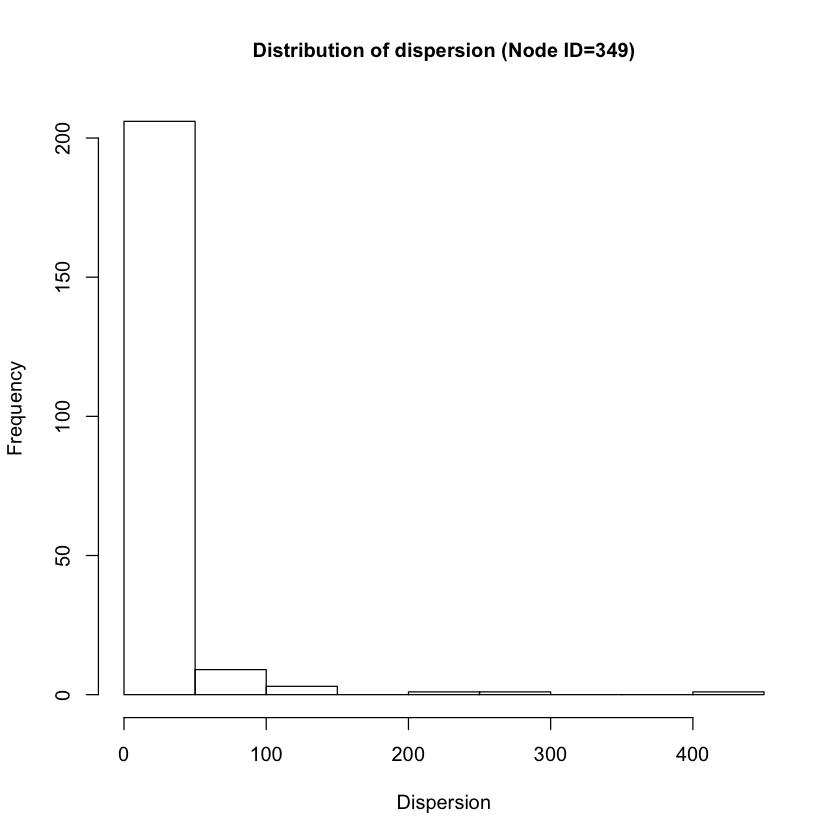

In [40]:
emb_disp349=emb_disp_hist(g, 349)
emb_disp349

  [1] 4971   33  110  112  125    0    0    0    0   46    0    0    0    0    0
 [16]    0    0    0    0    0   31    0    0    0    6    3    0    0    0    1
 [31]    8    0    0    0    0    4    0   44    0    0   37    0    0    0    0
 [46]    0    0    1    0    0    0    0    0    0   39    0    1    0    4    0
 [61]    0  126    0    0    0    0    0    0    0    2    3    0   41    0   24
 [76]    6    0   51    0  303    0   24   12    0    0    0    0    0    0    0
 [91]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[106]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[121]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[136]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[151]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[166]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[181]    0    0    0    0   

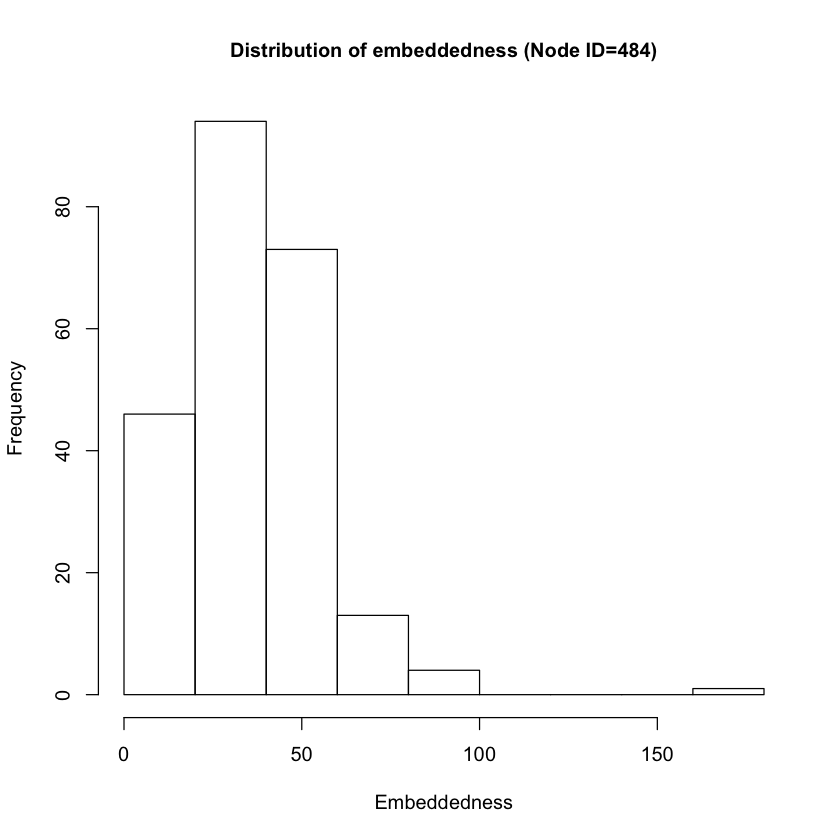

$emb
 107  348  353  363  366  367  370  373  374  376  378  385  388  391  392  395 
 166   73   90   84   84   13   46   58   49   76   46    6   28   44   32   46 
 397  404  408  412  414  416  417  419  420  422  430  431  432  436  438  444 
  16   31   34   59   47   18   45   31   26   18   27   49   32   41   49   25 
 446  461  463  465  473  475  479  482  484  487  492  493  494  496  497  500 
  13   37   18   53   19   79   21   24   78   25   52   36   14   29   51   52 
 503  506  507  513  514  515  517  520  524  525  526  527  537  538  542  544 
  43   49   43   62   45   42   80   32   48   49   42   38   33   68   39   42 
 553  557  559  560  561  563  566  567  580  591  596  601  604  606  614  637 
  46   18   62   21   58   29   67   39   77   35   15   17   28   64   23   83 
 639  641  651  669  896  917  919  930  933  936  942  948  954  962  976  984 
   3   49   57   29   48   57   26   46   14   34   52   33   41   14   22   34 
1001 1012 1014 1018 1020 1025 1032 1066 1080 1086 1095 1099 1102 1104 1108 1113 
  29   23   61   44   45   20   60   56   53   20   18   49   43   36   37   44 
1114 1122 1142 1148 1155 1158 1166 1179 1192 1204 1210 1237 1245 1261 1273 1277 
  29   45   29   20   36   20   39   42   30   41   31   48   35   53   39   49 
1281 1282 1284 1294 1300 1303 1309 1313 1318 1320 1324 1332 1349 1357 1358 1373 
  36   51   20   16   29   36   36   31   38   60   36   37   37   20   73   47 
1374 1382 1392 1396 1397 1400 1406 1408 1425 1427 1429 1446 1454 1455 1464 1473 
  39   37   15   47   14   20   23   17   18   54   23   31   44    4   22   21 
1475 1487 1490 1492 1495 1508 1512 1514 1515 1536 1543 1545 1565 1574 1582 1595 
  24   39    8    3   47   31   30   33   46   20   29   25   38   57   37   31 
1606 1611 1616 1625 1631 1638 1645 1654 1660 1661 1673 1677 1679 1680 1682 1692 
  30   14   47   22    8   27   52    5   20   56   37   34   24   13   10   41 
1694 1695 1706 1720 1729 1732 1740 1742 1744 1751 1763 1766 1767 1773 1778 1783 
  20   27   27   17   58   35   34   57   33   45   28   36   33   21   27   53 
1786 1790 1794 1801 1812 1820 1824 1828 1844 1848 1850 1870 1871 1878 1881 1893 
  59   25   22   20   36   54   45   37   58   32   13   21   60   32   27   56 
1894 1899 1875 1882 1907  535  671 
  47   20   11   48   26    5    3 

$disp
  [1] 4971   33  110  112  125    0    0    0    0   46    0    0    0    0    0
 [16]    0    0    0    0    0   31    0    0    0    6    3    0    0    0    1
 [31]    8    0    0    0    0    4    0   44    0    0   37    0    0    0    0
 [46]    0    0    1    0    0    0    0    0    0   39    0    1    0    4    0
 [61]    0  126    0    0    0    0    0    0    0    2    3    0   41    0   24
 [76]    6    0   51    0  303    0   24   12    0    0    0    0    0    0    0
 [91]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[106]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[121]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[136]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[151]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[166]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[181]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[196]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[211]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[226]    0    0    0    0    0    0

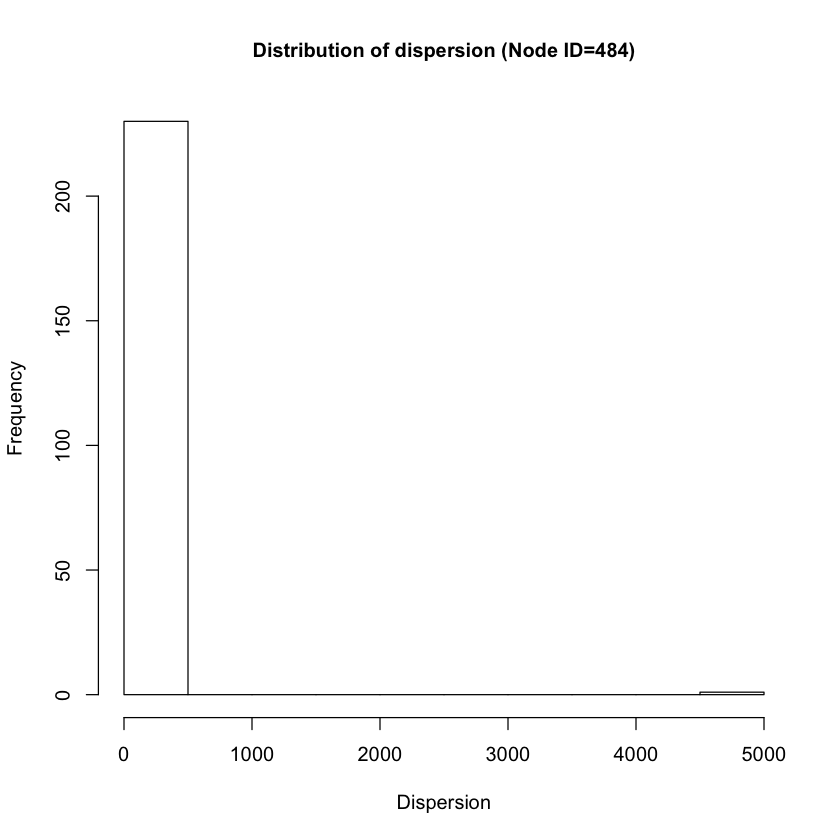

In [32]:
emb_disp484=emb_disp_hist(g, 484)
emb_disp484

  [1] 4675    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [16]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [31]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [46]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [61]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [76]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [91]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[106]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[121]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[136]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[151]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[166]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[181]    0    0    0    0   

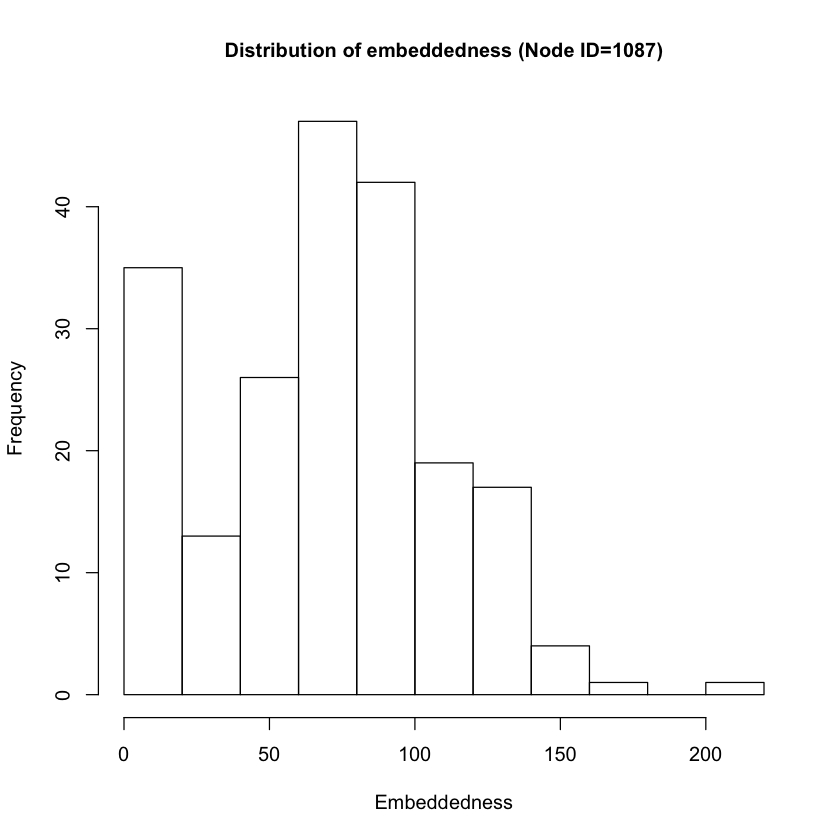

$emb
 107  483  596  606  637  641  916  917  925  934  946  947  952  953  960  966 
 204   20    8   11   16   13   95   13  101   61  110   77   62   69   72   88 
 978  980  983  993 1003 1006 1022 1024 1029 1032 1049 1054 1059 1060 1068 1075 
  64   72   42   99   54   95    2   64   38   10   48   32  113    8   35   44 
1076 1078 1079 1080 1083 1091 1101 1112 1117 1123 1125 1126 1128 1130 1132 1135 
  98  123   86   10   78   14   85   35   80   38   87  133   70   46  107   45 
1143 1146 1149 1153 1156 1163 1164 1172 1175 1180 1184 1185 1192 1198 1199 1201 
   6   92   59  100   70   78   16   76   84   27  107  110    9   61  142   37 
1207 1211 1214 1222 1235 1238 1243 1250 1255 1256 1267 1271 1273 1285 1288 1289 
  56  115   70   81   14   96   72   90   76   93   84   76    9   43   70   64 
1291 1298 1302 1312 1318 1329 1330 1335 1339 1344 1351 1352 1358 1367 1370 1375 
  78    7   85   42   10   78   76   90   67   59   48  138   13  106   85   46 
1376 1377 1390 1391 1399 1402 1416 1418 1423 1427 1429 1431 1436 1447 1449 1456 
 110  114  133  113  122   50   76    6    7   11    8  142   10   89   61  100 
1457 1463 1467 1471 1480 1483 1488 1509 1516 1517 1522 1539 1547 1556 1557 1563 
  46    9   73  119   56   61   94   74  110   23   95   53   91   23   92   62 
1565 1570 1571 1589 1598 1600 1603 1604 1605 1608 1610 1613 1617 1619 1620 1621 
  11   67   36  129  103   80   97   92   60   74  122  122   77   87   74  125 
1622 1632 1643 1652 1659 1660 1662 1663 1665 1668 1674 1675 1679 1680 1688 1689 
 113   54   70   59   58    7  100  144   91   94    4   70    5    7   50   83 
1707 1714 1715 1717 1721 1722 1727 1730 1735 1736 1737 1741 1746 1750 1753 1754 
 130  126    7   93   77   30    6  130   75  105   59   71  138   87   48   28 
1757 1761 1768 1789 1799 1800 1804 1809 1810 1813 1823 1827 1832 1833 1835 1842 
  95   75  121   82  103  151  136   82   70   85   92  122   34  136  101   69 
1844 1849 1861 1867 1868 1877 1879 1886 1888 1898 1902 1830 1907 
  11   88   52   75   82   42  111   76  162   67   84    6    4 

$disp
  [1] 4675    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [16]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [31]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [46]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [61]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [76]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
 [91]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[106]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[121]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[136]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[151]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[166]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[181]    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
[196]    0    0    0    0    0    0    0    0    0    0

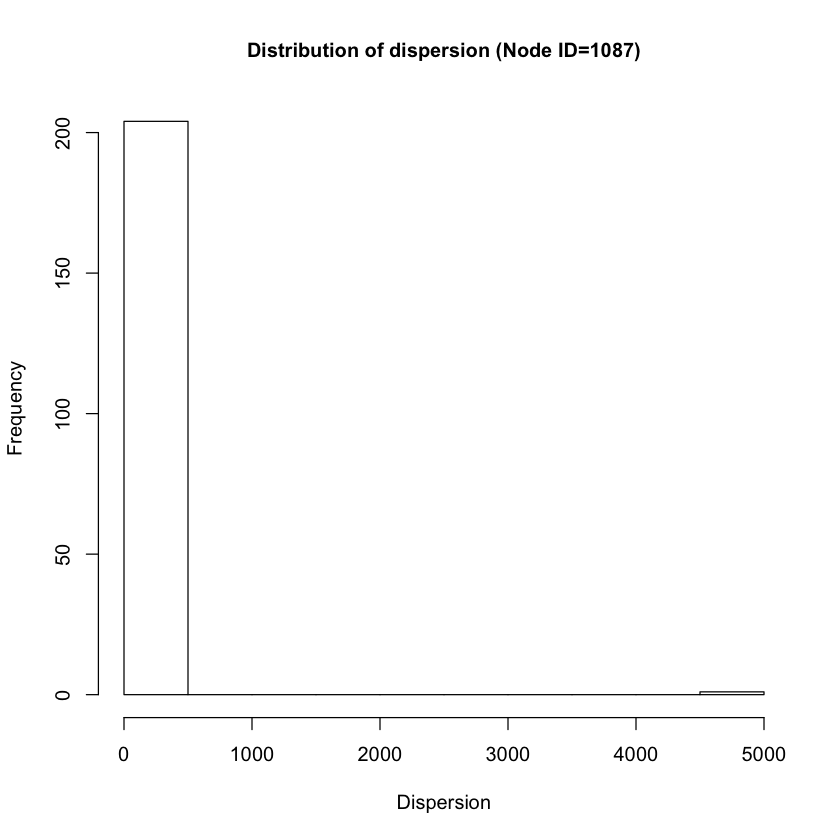

In [39]:
emb_disp1087=emb_disp_hist(g, 1087)
emb_disp1087

## Question 13:

In [151]:
sum(is.na(sum_dist))
max_sum_dist=max(sum_dist, na.rm=TRUE)
max_sum_dist
max_sum_dist_index=which(sum_dist %in% max_sum_dist)
max_sum_dist_index
V(g1)[max_sum_dist_index]

[1] 43

[1] 483

[1] 21

+ 1/348 vertex, named, from 57bb53a:
[1] 24

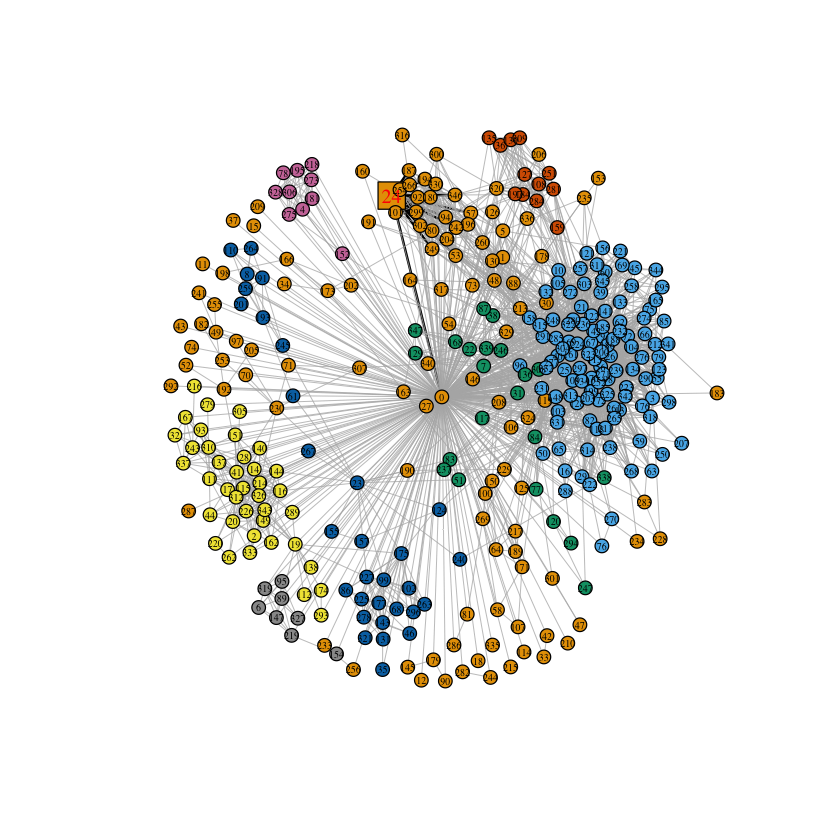

In [188]:
set.seed(0)
g1=make_ego_graph(g, order=1, nodes=V(g)[name==(1-1)], mode="all")[[1]] 
cfg=cluster_fast_greedy(g1)
coords = layout_with_fr(g1)

ecol <- rep("grey70", ecount(g1))
inc.edges1 <- incident(g1,  V(g1)[max_sum_dist_index], mode="all")
ecol[inc.edges1] <- "black"

ew <- rep(0.6, ecount(g1))
ew[inc.edges1] <- 2

vsize=rep(5, vcount(g1))
vsize[V(g1)[max_sum_dist_index]]=10
vshape=rep("circle", vcount(g1))
vshape[V(g1)[max_sum_dist_index]]="square"
vlsize=rep(0.5, vcount(g1))
vlsize[V(g1)[max_sum_dist_index]]=1
vlcol=rep("black", vcount(g1))
vlcol[V(g1)[max_sum_dist_index]]="red"

plot(g1, layout=coords, vertex.color=membership(cfg), edge.color=ecol, edge.width=ew,
     vertex.size=vsize, vertex.shape=vshape,vertex.label.cex=vlsize, vertex.label.color=vlcol)
     #, mark.col=NA,  mark.border=NA)

In [208]:
high_disp=function(g, id, emb_disp){
    set.seed(0)
    gg=make_ego_graph(g, order=1, nodes=V(g)[name==(id-1)], mode="all")[[1]] 
    
    max_disp=max(emb_disp$disp, na.rm=TRUE)
    max_disp_index=which(emb_disp$disp %in% max_disp) #node index for the node with highest dispersion
    disp_id= V(gg)[max_disp_index] #node id for the node with highest dispersion
    
    cfg=cluster_fast_greedy(gg)
    coords = layout_with_fr(gg)
    
    ecol <- rep("grey40", ecount(gg)) #default edge color=grey
    inc.edges <- incident(gg,  V(gg)[max_disp_index], mode="all")
    ecol[inc.edges] <- "black" #highlight highest dispersion edge incident to edge color=black
    ew <- rep(0.6, ecount(gg)) #default edge width=0.6
    ew[inc.edges] <- 2 #highlight highest dispersion edge incident to edge width=2
    
    vsize=rep(5, vcount(gg)) #default vertex size=5
    vsize[V(g1)[max_disp_index]]=10 #highlight highest dispersion vertex size=2
    vshape=rep("circle", vcount(gg))
    vshape[V(gg)[max_disp_index]]="square"
    vlsize=rep(0.5, vcount(gg)) #default label size=0.5
    vlsize[V(gg)[max_disp_index]]=1 #highlight highest dispersion label size=1
    vlcol=rep("black", vcount(gg))
    vlcol[V(gg)[max_disp_index]]="red"

    plot(gg, layout=coords, vertex.color=membership(cfg), edge.color=ecol, edge.width=ew,
         vertex.size=vsize, vertex.shape=vshape,vertex.label.cex=vlsize, vertex.label.color=vlcol)
    return(disp_id)
}

+ 1/348 vertex, named, from 85e0f2a:
[1] 24

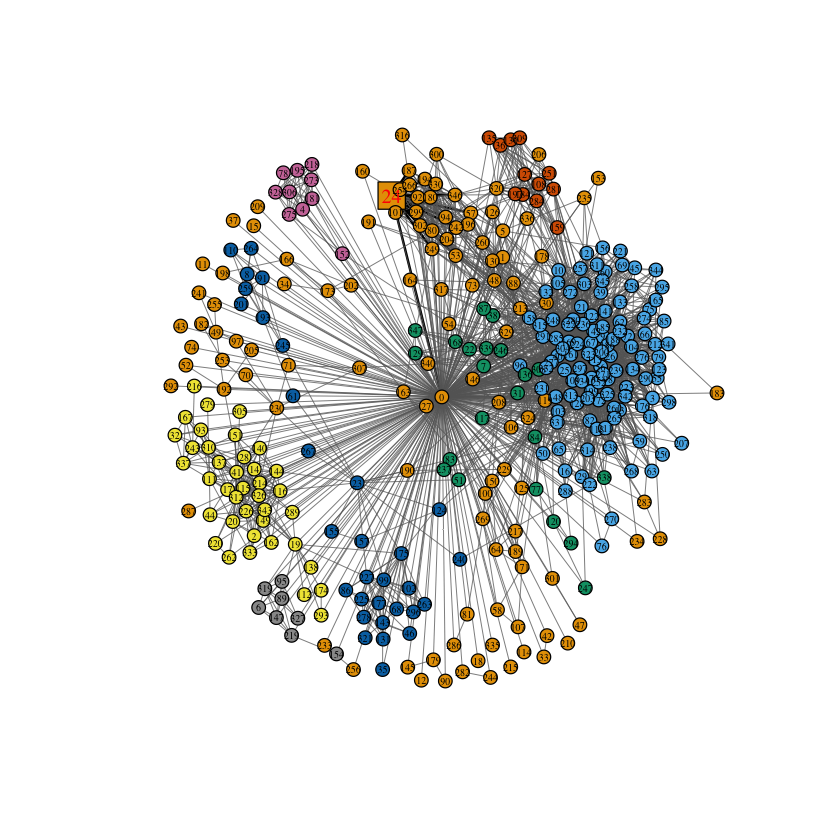

In [191]:
disp_id1=high_disp(g, 1, emb_disp1)
disp_id1

+ 1/1046 vertex, named, from 3822b13:
[1] 475

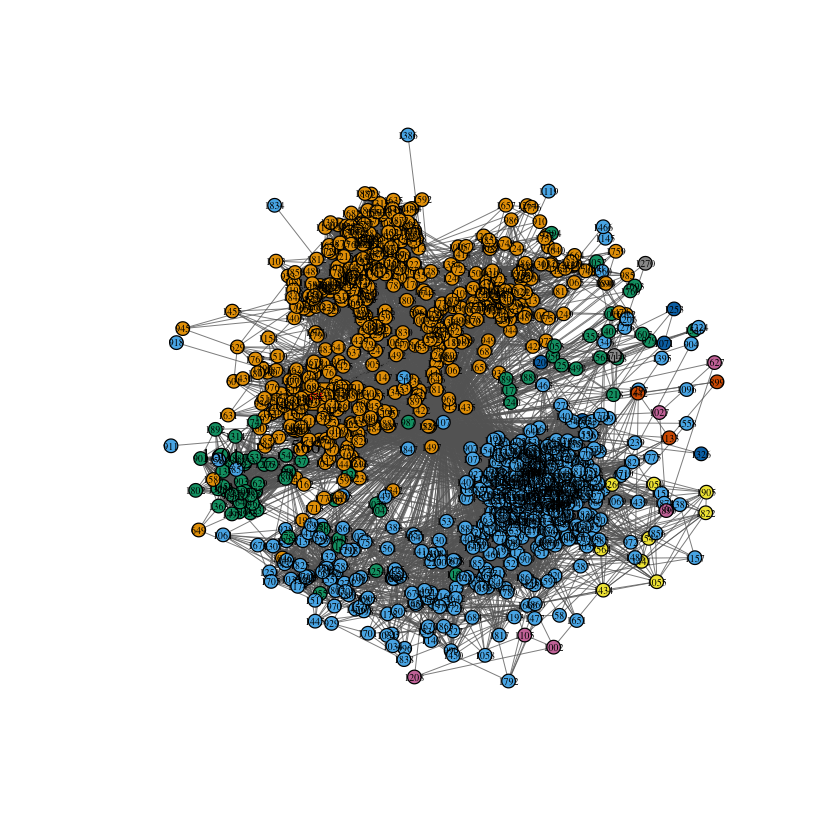

In [190]:
disp_id108=high_disp(g, 108, emb_disp108)
disp_id108

+ 1/230 vertex, named, from 6e37fdf:
[1] 561

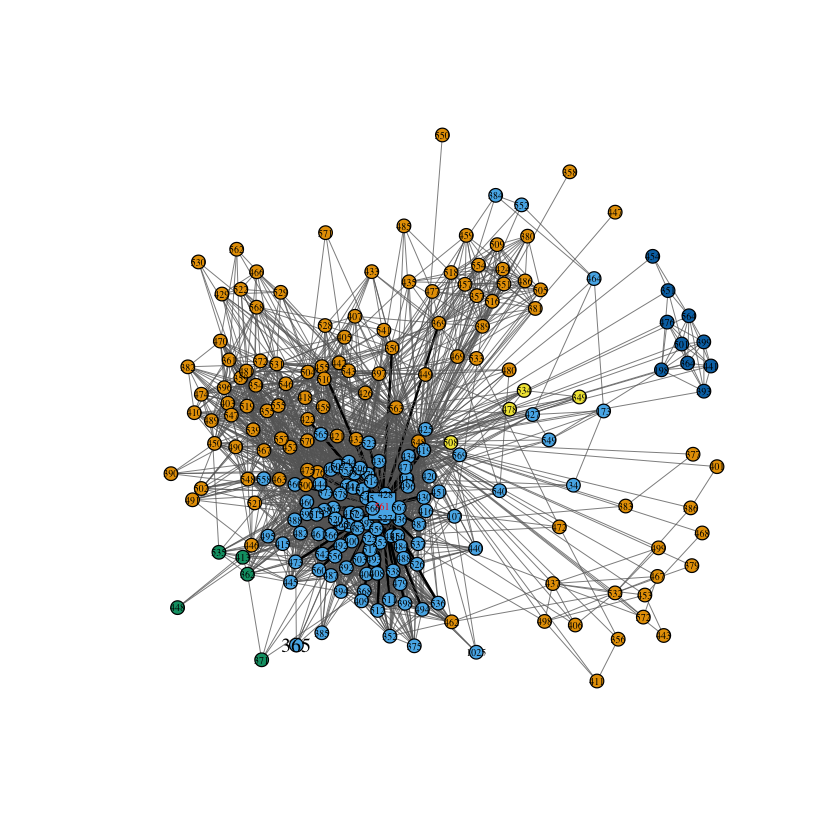

In [192]:
disp_id349=high_disp(g, 349, emb_disp349)
disp_id349

+ 1/232 vertex, named, from 840e1c1:
[1] 107

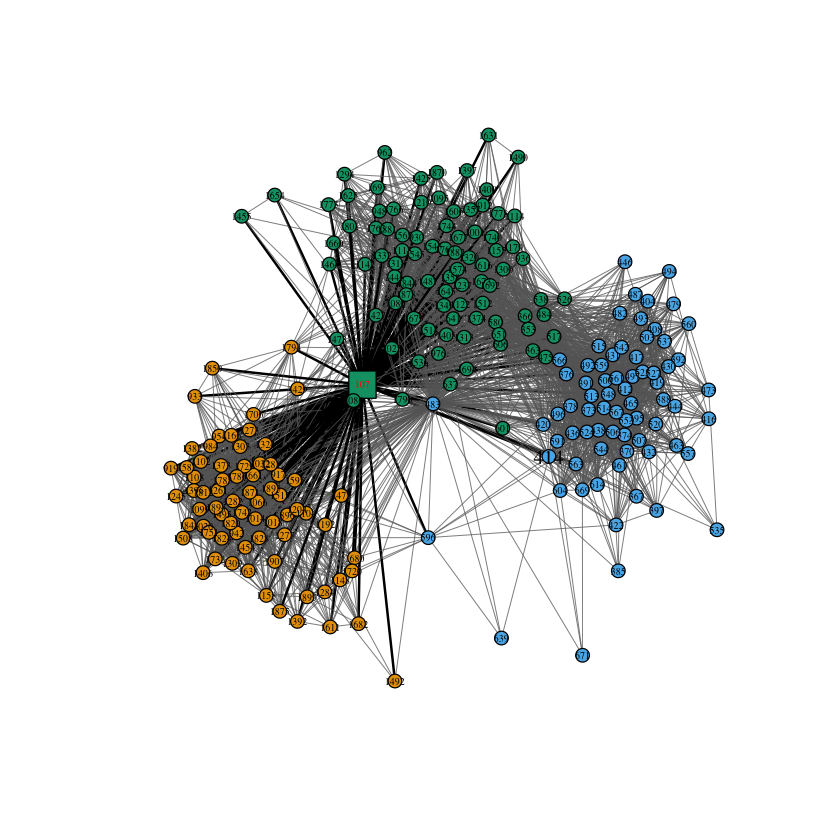

In [193]:
disp_id484=high_disp(g, 484, emb_disp484)
disp_id484

+ 1/206 vertex, named, from 0bff143:
[1] 107

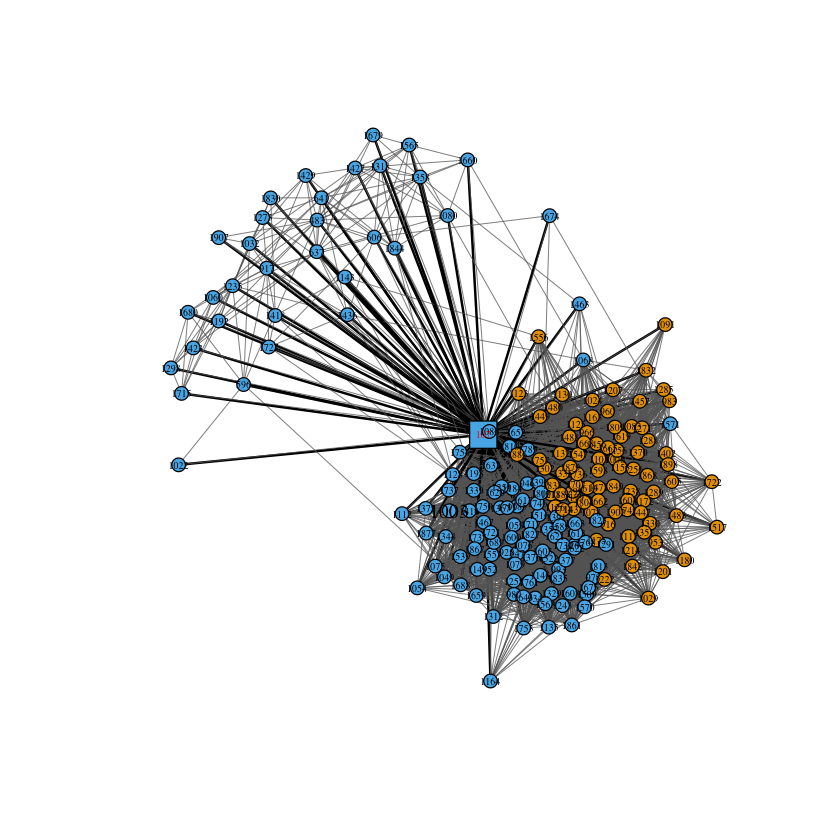

In [194]:
disp_id1087=high_disp(g, 1087, emb_disp1087)
disp_id1087

## Question 14:

In [203]:
min(degree(G1))
max_emb=max(degree(G1), na.rm=TRUE)
max_emb
max_emb_index=which(degree(G1) %in% max_emb)
max_emb_index
V(g1)[max_emb_index]

#sum_dist/degree(G1)
max_emb_disp=max(sum_dist/degree(G1), na.rm=TRUE)
max_emb_disp
max_emb_disp_index=which((sum_dist/degree(G1)) %in% max_emb_disp)
max_emb_disp_index
V(g1)[max_emb_disp_index]

[1] 0

[1] 77

[1] 49

+ 1/348 vertex, named, from d520ba2:
[1] 55

[1] 7.52459

[1] 110

+ 1/348 vertex, named, from d520ba2:
[1] 118

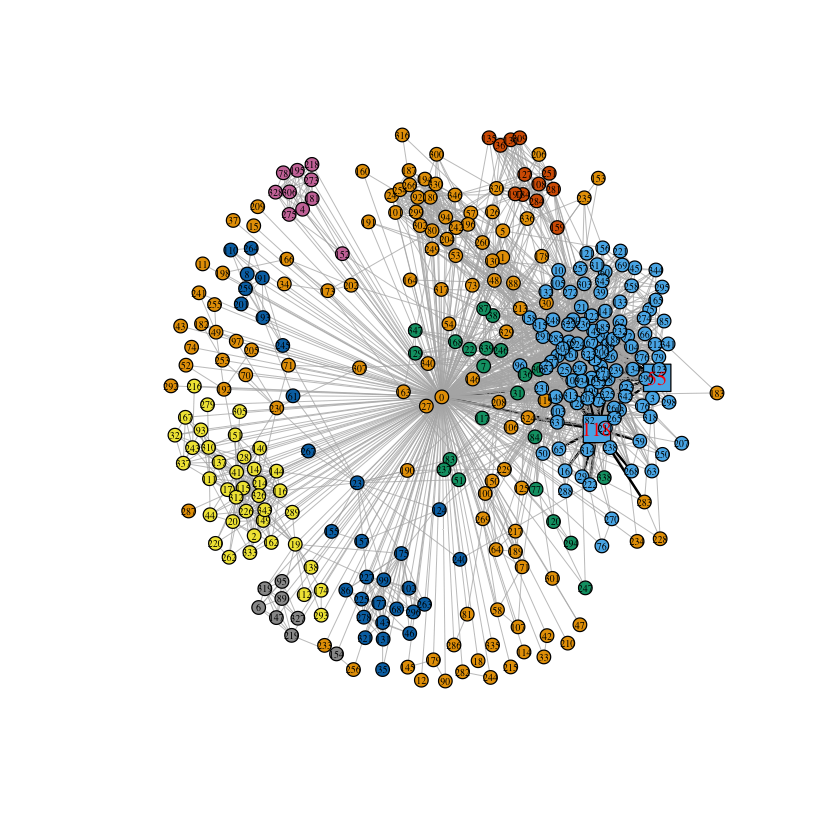

In [209]:
set.seed(0)
g1=make_ego_graph(g, order=1, nodes=V(g)[name==(1-1)], mode="all")[[1]] 
cfg=cluster_fast_greedy(g1)
coords = layout_with_fr(g1)

ecol <- rep("grey70", ecount(g1))
inc.edges1 <- c(incident(g1, V(g1)[max_emb_index], mode="all"), incident(g1, V(g1)[max_emb_disp_index], mode="all"))
ecol[inc.edges1] <- "black"

ew <- rep(0.6, ecount(g1))
ew[inc.edges1] <- 2

vsize=rep(5, vcount(g1))
vsize[V(g1)[max_emb_index, max_emb_disp_index]]=10
vshape=rep("circle", vcount(g1))
vshape[V(g1)[max_emb_index, max_emb_disp_index]]="square"
vlsize=rep(0.5, vcount(g1))
vlsize[V(g1)[max_emb_index, max_emb_disp_index]]=1
vlcol=rep("black", vcount(g1))
vlcol[V(g1)[max_emb_index, max_emb_disp_index]]="red"

plot(g1, layout=coords, vertex.color=membership(cfg), edge.color=ecol, edge.width=ew, 
     vertex.size=vsize, vertex.shape=vshape,vertex.label.cex=vlsize, vertex.label.color=vlcol)
     #, mark.col=NA,  mark.border=NA)

In [216]:
high_emb_disp=function(g, id, emb_disp){
    set.seed(0)
    gg=make_ego_graph(g, order=1, nodes=V(g)[name==(id-1)], mode="all")[[1]] 
    
    max_emb=max(emb_disp$emb, na.rm=TRUE)
    max_emb_index=which(emb_disp$emb %in% max_emb)
    emb_id= V(gg)[max_emb_index] 
    
    max_emb_disp=max(emb_disp$disp/emb_disp$emb, na.rm=TRUE)
    max_emb_disp_index=which((emb_disp$disp/emb_disp$emb) %in% max_emb_disp) #node index for the node with highest dispersion/embeddedness
    emb_disp_id= V(gg)[max_emb_disp_index] 
    
    cfg=cluster_fast_greedy(gg)
    coords = layout_with_fr(gg)
    
    ecol <- rep("grey40", ecount(gg)) #default edge color=grey
    inc.edges <- c(incident(gg,V(gg)[max_emb_index],mode="all"), incident(gg,V(gg)[max_emb_disp_index],mode="all"))
    ecol[inc.edges] <- "black" #highlight highest dispersion edge incident to edge color=black
    ew <- rep(0.6, ecount(gg)) #default edge width=0.6
    ew[inc.edges] <- 2 #highlight highest dispersion edge incident to edge width=2
    
    vsize=rep(5, vcount(gg)) #default vertex size=5
    vsize[V(gg)[max_emb_index, max_emb_disp_index]]=10 #highlight highest dispersion vertex size=2
    vshape=rep("circle", vcount(gg))
    vshape[V(gg)[max_emb_index, max_emb_disp_index]]="square"
    vlsize=rep(0.5, vcount(gg)) #default label size=0.5
    vlsize[V(gg)[max_emb_index, max_emb_disp_index]]=1 #highlight highest dispersion label size=1
    vlcol=rep("black", vcount(gg))
    vlcol[V(gg)[max_emb_index, max_emb_disp_index]]="red"

    plot(gg, layout=coords, vertex.color=membership(cfg), edge.color=ecol, edge.width=ew, 
         vertex.size=vsize, vertex.shape=vshape,vertex.label.cex=vlsize, vertex.label.color=vlcol)
    ids=list("emb_id" = emb_id, "emb_disp_id" = emb_disp_id)
    return(ids)
}

$emb_id
+ 1/348 vertex, named, from 6539417:
[1] 55

$emb_disp_id
+ 1/348 vertex, named, from 6539417:
[1] 118


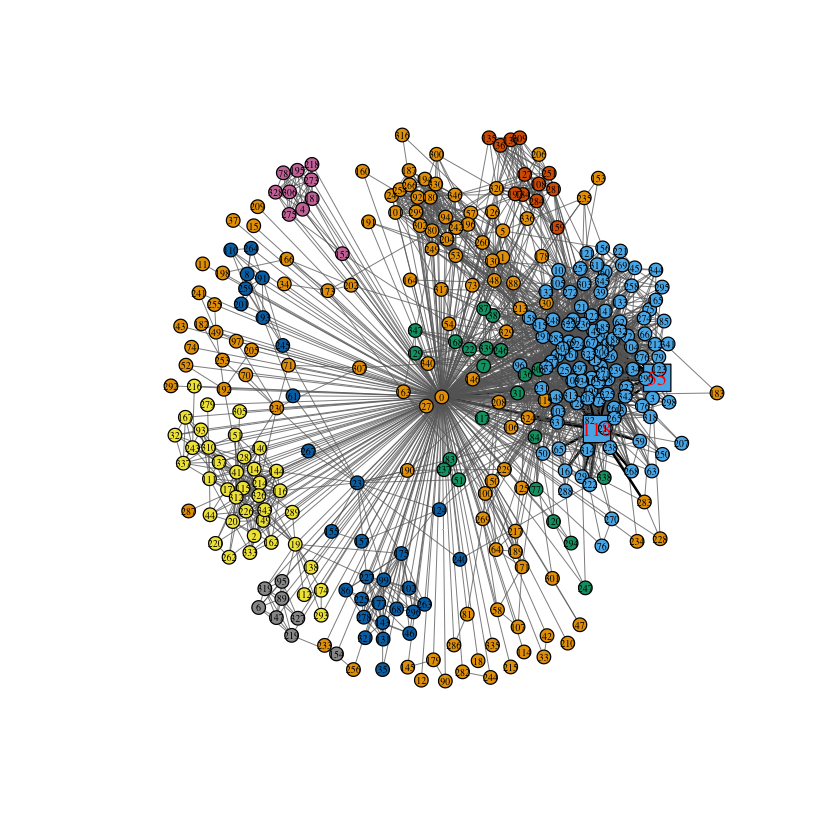

In [214]:
high_emb_disp(g, 1, emb_disp1)

$emb_id
+ 1/1046 vertex, named, from 50d4f91:
[1] 1887

$emb_disp_id
+ 1/1046 vertex, named, from 50d4f91:
[1] 475


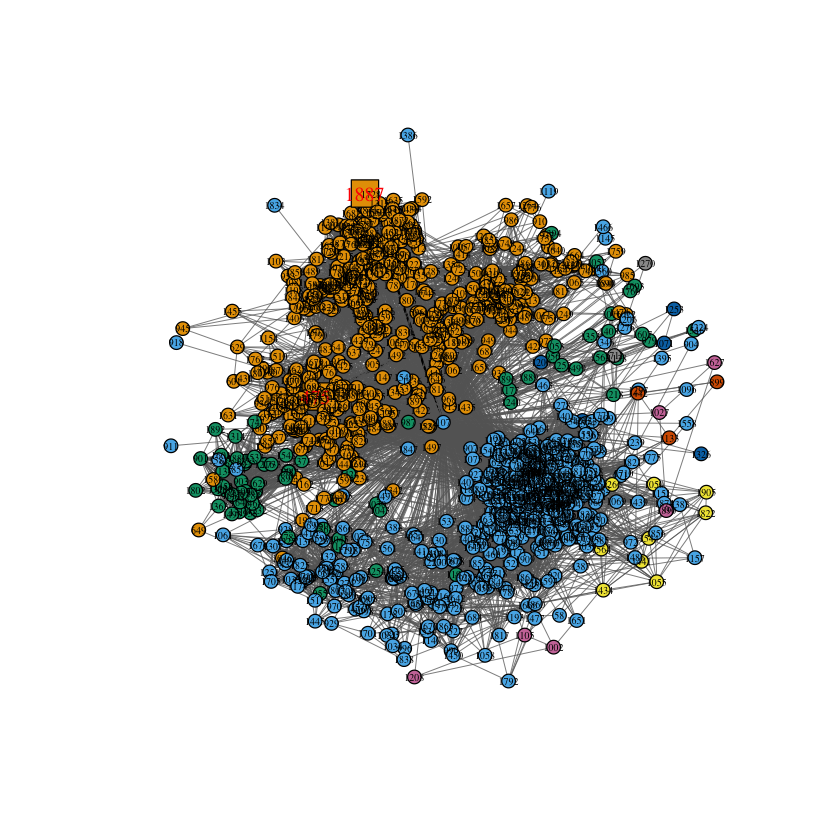

In [217]:
high_emb_disp(g, 108, emb_disp108)

$emb_id
+ 1/230 vertex, named, from b12b2c3:
[1] 375

$emb_disp_id
+ 1/230 vertex, named, from b12b2c3:
[1] 561


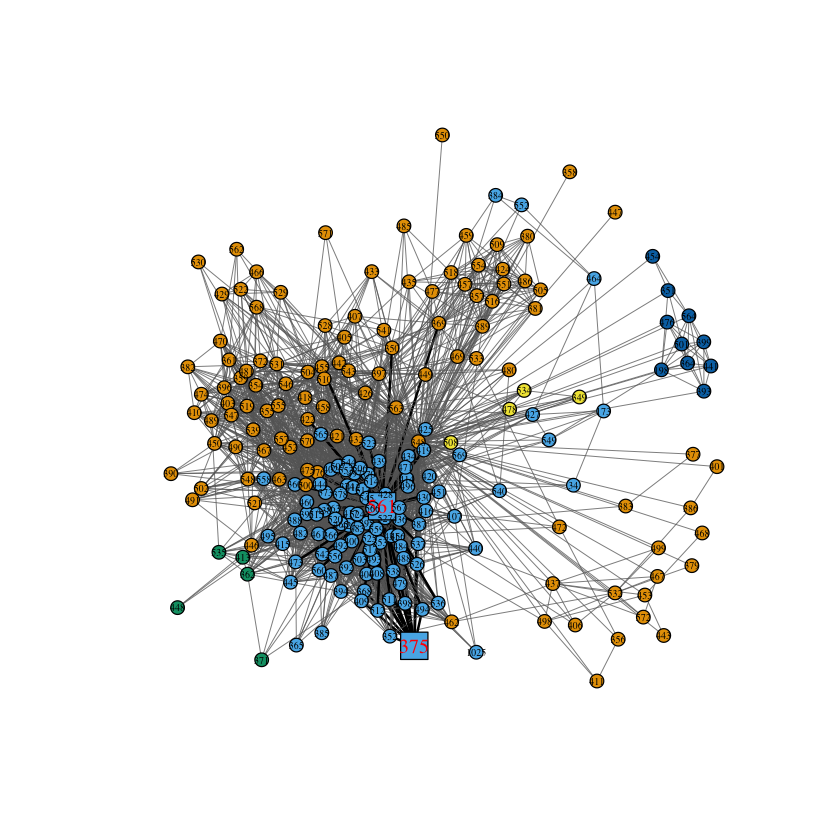

In [218]:
high_emb_disp(g, 349, emb_disp349)

$emb_id
+ 1/232 vertex, named, from ed410f1:
[1] 107

$emb_disp_id
+ 1/232 vertex, named, from ed410f1:
[1] 107


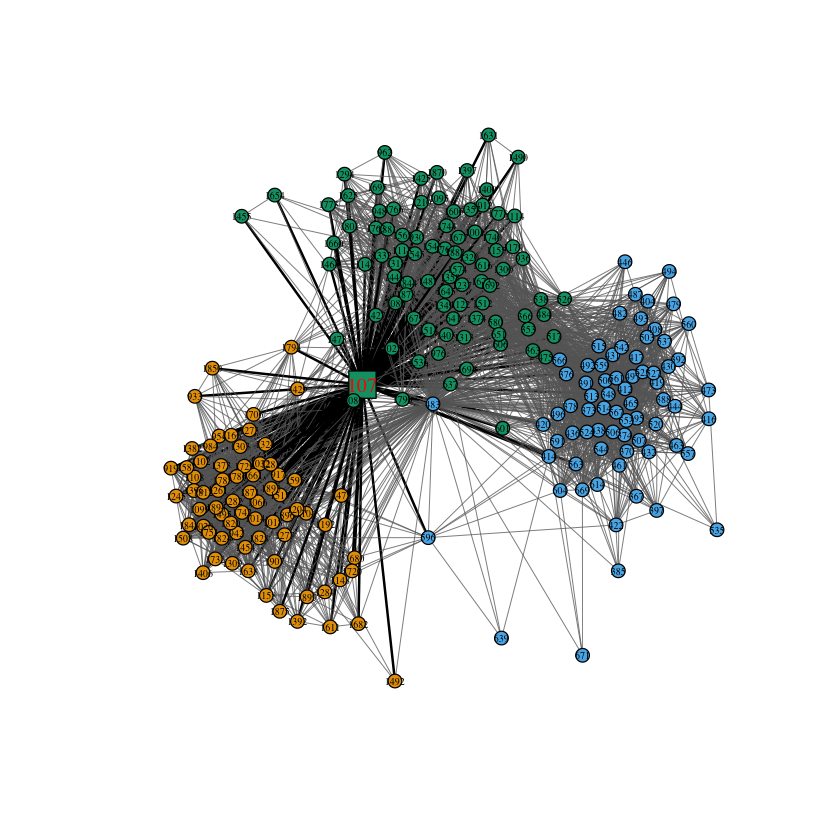

In [219]:
high_emb_disp(g, 484, emb_disp484)

$emb_id
+ 1/206 vertex, named, from 26a1843:
[1] 107

$emb_disp_id
+ 1/206 vertex, named, from 26a1843:
[1] 107


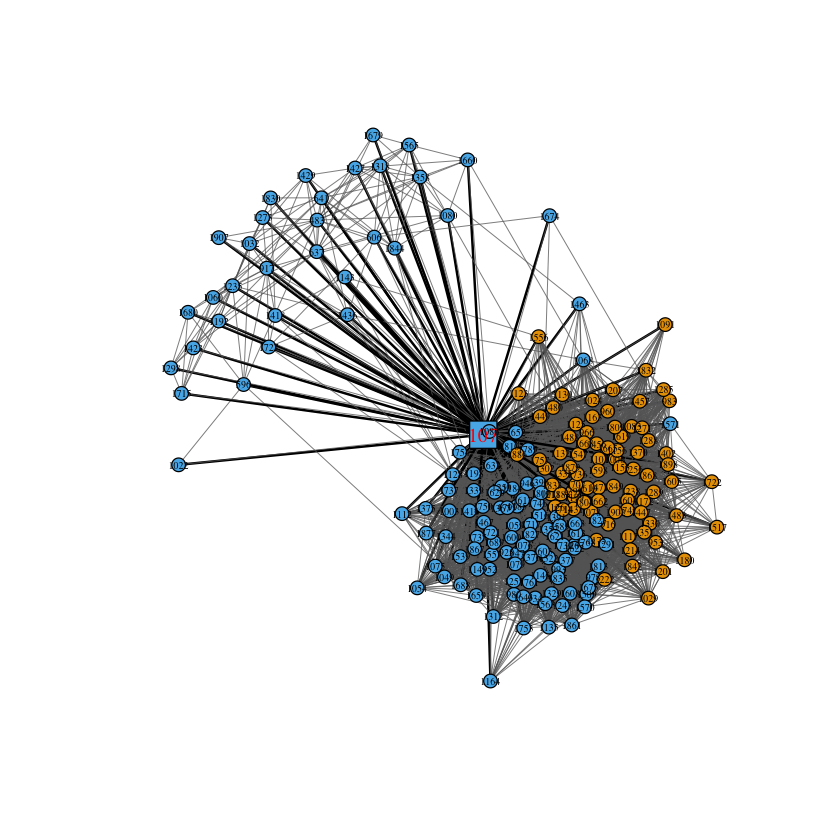

In [220]:
high_emb_disp(g, 1087, emb_disp1087)

## Question 15:

Measured by highest embeddedness, the node selected tend to be the center of the highest density cluster (subcluster) area. Measured by highest dispersion or dispersion/embeddedness, the node selected tend to be around the node bridging mutiple clusters. If the bridging node happens to be the one with most connection, the highest embeddedness and highest dispersion or dispersion/embeddedness tend to select the same node.

## Question 16:

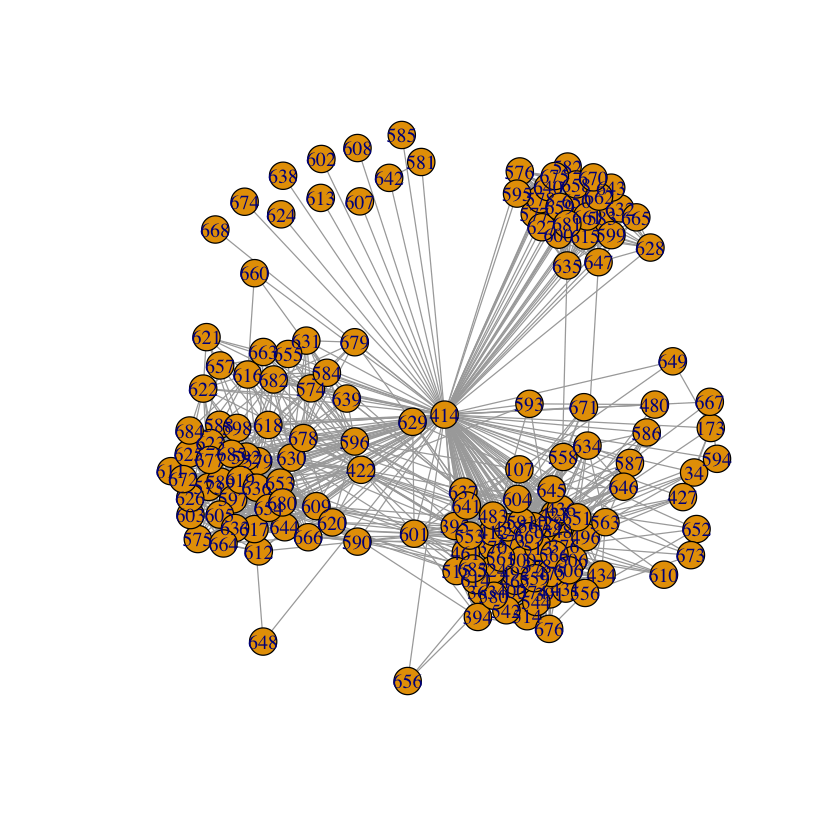

In [232]:
set.seed(0)
g415=make_ego_graph(g, order=1, nodes=V(g)[name==(415-1)], mode="all")[[1]] #make_ego_graph preserves the vertex, edge and graph attributes
#g415=make_ego_graph(g, order=1, '414', mode="all")[[1]] 
plot(g415, vertex.size=10)

In [233]:
vcount(g415)

[1] 160

In [455]:
V(g415)[degree(g415)==24]
length(V(g415)[degree(g415)==24])
unames=as_ids(V(g415)[degree(g415)==24])
unames

+ 11/160 vertices, named, from 54ccbe6:
 [1] 496 578 600 615 618 627 643 658 659 661 662

[1] 11

[1] "496" "578" "600" "615" "618" "627" "643" "658" "659" "661" "662"

## Question 17:

In [450]:
#Common Neighbors measure
#Common Neighbors measure=length(intersect(Si, Sj))
unames=as_ids(V(g415)[degree(g415)==24])
#acc_all_users=matrix(nrow=length(V(g415)[degree(g415)==24], ncol=3)
acc_all_users=c() 
u=1
for (uname in unames){
    eseq=incident(g415, uname) #find edge for each user
    #acc_each_user=matrix(nrow=10, ncol=3)
    acc_each_user=c()
    for (s in 1:10){ #each user iterate 10 times
        remove_edge=sample(eseq, length(eseq), replace = TRUE, prob = rep(0.25,length(eseq)))
        Ri_edge=unique(remove_edge)
        g415_re=g415-Ri_edge
        Si=neighbors(g415_re, uname)
        Ri_index=setdiff(neighbors(g415, uname), Si) #deleted friend node indices
        Ri=V(g415)[Ri_index] #deleted friend node names
        nodej=setdiff(V(g415),Si)
        
        cn=c()
        for (j in nodej){
            Sj=neighbors(g415_re, j) 
            cn_index=intersect(Si, Sj) 
            cn[[j]] =length(cn_index)
        }
        high_cn=head(cn[order(-cn)], length(Ri)) #top |Ri| cn
        high_cn_index=which(cn %in% high_cn)
        Pi=V(g415)[head(high_cn_index, length(Ri))]
        acc_each_user[[s]]=length(intersect(Pi, Ri))/length(Ri)
    }
    print(acc_each_user)
    acc_all_users[[u]]=mean(acc_each_user)
    u=u+1
}
print(acc_all_users)
mean(acc_all_users)

 [1] 0.4375000 0.4375000 0.5333333 0.4666667 0.4285714 0.4285714 0.3571429
 [8] 0.4705882 0.5000000 0.4285714
 [1] 0.9285714 0.9375000 0.9333333 0.8823529 0.9230769 0.9375000 0.9375000
 [8] 0.9333333 0.9375000 0.9411765
 [1] 0.8666667 0.8461538 0.8461538 0.8750000 0.8750000 0.8571429 0.8571429
 [8] 0.8666667 0.8666667 0.8823529
 [1] 0.8571429 0.8888889 0.8666667 0.8823529 0.8823529 0.8750000 0.8666667
 [8] 0.8823529 0.8666667 0.8750000
 [1] 0.5625000 0.4375000 0.5625000 0.4666667 0.5333333 0.2666667 0.4666667
 [8] 0.5333333 0.5000000 0.5000000
 [1] 0.8823529 0.8888889 0.9411765 0.9285714 0.9411765 0.9333333 0.9166667
 [8] 0.9285714 0.9230769 0.9411765
 [1] 0.8571429 0.9375000 0.8750000 0.8823529 0.8823529 0.8750000 0.8666667
 [8] 0.9375000 0.8823529 0.8666667
 [1] 0.9333333 0.9411765 0.9375000 0.8571429 0.9375000 0.9375000 0.9230769
 [8] 0.9285714 0.9375000 0.9285714
 [1] 0.9230769 0.8750000 0.9333333 0.9230769 0.9375000 0.9285714 0.9285714
 [8] 0.9411765 0.9285714 0.8947368
 [1] 0.857

[1] 0.8217009

In [453]:
#Jaccard measure
#for (uname in unames){
#for (s in 1:10){
    #ramdom select length(edge sequence) (which is num_friend_recommended = |Ri|) to remove, which means remove friends from node i
    #find neighbor of node i in edge removed graph
    #find the removed friends
    #find nodes that are not neighbor of i in edge removed graph (nodej)
    #use Jaccard neighbor measure find Jaccard score for each element in nodej
        #which is using: Jaccard measure=length(intersect(Si, Sj))/length(union(Si, Sj))
    #pick the top |Ri| highest Jaccard score nodes as the friends being recommended
    #calculate accuracy of friend recommendation
#}
#}
unames=as_ids(V(g415)[degree(g415)==24])
#acc_all_users=matrix(nrow=length(V(g415)[degree(g415)==24], ncol=3)
acc_all_users=c() 
u=1
for (uname in unames){
    eseq=incident(g415, uname) #find edge for each user
    #acc_each_user=matrix(nrow=10, ncol=3)
    acc_each_user=c()
    for (s in 1:10){ #each user iterate 10 times
        remove_edge=sample(eseq, length(eseq), replace = TRUE, prob = rep(0.25,length(eseq)))
        Ri_edge=unique(remove_edge)
        g415_re=g415-Ri_edge
        Si=neighbors(g415_re, uname)
        Ri_index=setdiff(neighbors(g415, uname), Si) #deleted friend node indices
        Ri=V(g415)[Ri_index] #deleted friend node names
        nodej=setdiff(V(g415),Si)
        
        ja=c()
        for (j in nodej){
            Sj=neighbors(g415_re, j) 
            #cn_index=intersect(Si, Sj) 
            #cn[[j]] =length(cn_index)
            ja[[j]]=length(intersect(Si, Sj))/length(union(Si, Sj))
        }
        high_ja=head(ja[order(-ja)], length(Ri)) #top |Ri| cn
        high_ja_index=which(ja %in% high_ja)
        Pi=V(g415)[head(high_ja_index, length(Ri))]
        acc_each_user[[s]]=length(intersect(Pi, Ri))/length(Ri)
    }
    print(acc_each_user)
    acc_all_users[[u]]=mean(acc_each_user)
    u=u+1
}
print(acc_all_users)
mean(acc_all_users)

 [1] 0.3846154 0.2941176 0.3333333 0.4444444 0.3529412 0.2500000 0.1666667
 [8] 0.3529412 0.4000000 0.2000000
 [1] 0.9375000 0.9333333 0.8666667 0.9411765 0.8461538 0.9285714 0.8571429
 [8] 0.9375000 0.8750000 0.9375000
 [1] 0.9375000 0.9285714 0.8750000 0.8571429 0.8750000 0.8461538 0.8666667
 [8] 0.9285714 0.8823529 0.8666667
 [1] 0.8571429 0.8888889 0.8750000 0.8888889 0.8333333 0.8571429 0.8750000
 [8] 0.8750000 0.8571429 0.8823529
 [1] 0.5333333 0.4615385 0.5882353 0.5294118 0.3750000 0.5833333 0.5384615
 [8] 0.5833333 0.4705882 0.3571429
 [1] 0.8666667 0.8571429 0.8750000 0.8750000 0.9333333 0.9375000 0.8750000
 [8] 0.9444444 0.9375000 0.8823529
 [1] 0.8461538 0.9333333 0.8571429 0.9285714 0.8750000 0.8750000 0.8823529
 [8] 0.9230769 0.8571429 0.8666667
 [1] 0.9230769 0.8666667 0.8666667 0.8571429 0.8750000 0.8666667 0.9333333
 [8] 0.4736842 0.9333333 0.9333333
 [1] 0.8823529 0.9411765 0.8823529 0.8750000 0.9285714 0.8750000 0.8823529
 [8] 0.8571429 0.8823529 0.8571429
 [1] 0.846

[1] 0.7996627

In [454]:
#Adamic_Adar measure
#Adamic_Adar Neighbors measure= Sum(a+1/log(length(Sk))) if number of neighbor Sk >=1

unames=as_ids(V(g415)[degree(g415)==24])
#acc_all_users=matrix(nrow=length(V(g415)[degree(g415)==24], ncol=3)
acc_all_users=c() 
u=1
for (uname in unames){
    eseq=incident(g415, uname) #find edge for each user
    #acc_each_user=matrix(nrow=10, ncol=3)
    acc_each_user=c()
    for (s in 1:10){ #each user iterate 10 times
        remove_edge=sample(eseq, length(eseq), replace = TRUE, prob = rep(0.25,length(eseq)))
        Ri_edge=unique(remove_edge)
        g415_re=g415-Ri_edge
        Si=neighbors(g415_re, uname)
        Ri_index=setdiff(neighbors(g415, uname), Si) #deleted friend node indices
        Ri=V(g415)[Ri_index] #deleted friend node names
        nodej=setdiff(V(g415),Si)
        
        aa=c()
        for (j in nodej){
            Sj=neighbors(g415_re, j) 
            cn_index=intersect(Si, Sj) 
            a=0
            for (k in cn_index){
                Sk=neighbors(g415_re, k)
                if (length(Sk)<1){
                    a=a
                }
                else {
                    a=a+1/log(length(Sk))
                } 
            }
            aa[[j]]=a
        }
        high_aa=head(aa[order(-aa)], length(Ri)) #top |Ri| cn
        high_aa_index=which(aa %in% high_aa)
        Pi=V(g415)[head(high_aa_index, length(Ri))]
        acc_each_user[[s]]=length(intersect(Pi, Ri))/length(Ri)
    }
    print(acc_each_user)
    acc_all_users[[u]]=mean(acc_each_user)
    u=u+1
}
print(acc_all_users)
mean(acc_all_users)

 [1] 0.5384615 0.5625000 0.2142857 0.4444444 0.5333333 0.5000000 0.5384615
 [8] 0.3333333 0.5263158 0.5000000
 [1] 0.9285714 0.9333333 0.9333333 0.9411765 0.9333333 0.9285714 0.9333333
 [8] 0.9411765 0.9166667 0.9333333
 [1] 0.8571429 0.8461538 0.8947368 0.8571429 0.8750000 0.8666667 0.8571429
 [8] 0.9285714 0.8571429 0.9285714
 [1] 0.8823529 0.8666667 0.8461538 0.8823529 0.8666667 0.8461538 0.8666667
 [8] 0.8750000 0.8666667 0.8571429
 [1] 0.5000000 0.6666667 0.5000000 0.4615385 0.5625000 0.5000000 0.3333333
 [8] 0.6000000 0.6000000 0.6250000
 [1] 0.9444444 0.9333333 0.8823529 0.9333333 0.9333333 0.9230769 0.9230769
 [8] 0.9333333 0.8750000 0.9411765
 [1] 0.8823529 0.8571429 0.8823529 0.8750000 0.8571429 0.8333333 0.8750000
 [8] 0.8461538 0.8750000 0.8750000
 [1] 0.9411765 0.9411765 0.9285714 0.9411765 0.9444444 0.9333333 0.9333333
 [8] 0.9166667 0.9166667 0.9375000
 [1] 0.9333333 0.9411765 0.9411765 0.9230769 0.9285714 0.9333333 0.9285714
 [8] 0.8750000 0.8750000 0.8750000
 [1] 0.875

[1] 0.8290851

In [ ]:
# #combine all three neighborhood based measure, NOT DONE YET
# unames=as_ids(V(g415)[degree(g415)==24])
# acc_all_users=matrix(nrow=length(unames), ncol=3)
# #acc_all_users=c() 
# u=1
# for (uname in unames){
#     eseq=incident(g415, uname) #find edge for each user
#     acc_each_user=matrix(nrow=10, ncol=3)
#     #acc_each_user=c()
#     for (s in 1:10){ #each user iterate 10 times
#         remove_edge=sample(eseq, length(eseq), replace = TRUE, prob = rep(0.25,length(eseq)))
#         Ri_edge=unique(remove_edge)
#         g415_re=g415-Ri_edge
#         Si=neighbors(g415_re, uname)
#         Ri_index=setdiff(neighbors(g415, uname), Si) #deleted friend node indices
#         Ri=V(g415)[Ri_index] #deleted friend node names
#         nodej=setdiff(V(g415),Si)
        
#         cn=c()
#         for (j in nodej){
#             Sj=neighbors(g415_re, j) 
#             cn_index=intersect(Si, Sj) 
#             cn[[j]] =length(cn_index)
#         }
#         high_cn=head(cn[order(-cn)], length(Ri)) #top |Ri| cn
#         high_cn_index=which(cn %in% high_cn)
#         Pi=V(g415)[head(high_cn_index, length(Ri))]
#         acc_each_user[[s]]=length(intersect(Pi, Ri))/length(Ri)
#     }
#     print(acc_each_user)
#     acc_all_users[[u]]=mean(acc_each_user)
#     u=u+1
# }
# print(acc_all_users)
# mean(acc_all_users)